In [ ]:
!pip install openeo
!pip install rasterio

In [ ]:
# Conectar Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Configurar carpeta de trabajo en Drive
import os
work_dir = "/content/drive/MyDrive/CC3084_Lab4_Atitlan"
os.makedirs(work_dir, exist_ok=True)
os.chdir(work_dir)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import openeo
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

# Análisis lago de Atitlan

El óbjetivo de esta parte de la investigación es poder analizar el comportamiento de las cianobacterias en el lago de Atitlan a lo largo del tiempo. Para esto se estará trabajando con datos geoespaciales obtenidos del satélite Sentinel 2. Ahora bien, es importante tener en cuenta que las imágenes del satélite se toman cada 5 días aproximadamente y que se desea trabajar con información de al menos 3 meses atrás. Pero el detalles está en que no todas las imagenes tomadas en ese lapso de tiempo son 100% visibles. Las imagenes pueden estar afectadas por la nubosidad, oscuridad o incluso las imágenes pueden tener errores y/o obstruidas. Es por eso que se realizó una selección de fechas y las imagenes se obtuvieron de la API individualmente.

## Conexión con la API sentinel 2

In [ ]:
#1-3

connection = openeo.connect("https://openeo.dataspace.copernicus.eu").authenticate_oidc()

# Coordenadas exactas del Lago Atitlán
lago_atitlan = {
    "west": -91.326256,
    "east": -91.07151,
    "south": 14.5948,
    "north": 14.750979
}

fechas_prueba = [
    # Febrero (2 fechas)
    "2025-02-07",
    "2025-02-27",

    # Marzo (2 fechas)
    "2025-03-04",
    "2025-03-26",

    # Abril (2 fechas)
    "2025-04-03",
    "2025-04-28",

    # Mayo (2 fechas)
    "2025-05-03",
    "2025-05-28",

    # Julio (2 fechas - no hay datos en junio)
    #"2025-07-10", esta de aca tiene falla y parte de la imagen parece estar cortado
    "2025-07-24",

    # Agosto (1 fecha disponible)
    "2025-08-01"
]


Authenticated using refresh token.


Se deben de incluir distintas bandas necesarias para poder luego visualizr la imagen, hacer cálculos y la visualización de las cianobacterias. La inclusión de más bandas vuelve más pesado el procesamiento y descarga de la imagen, pero nos apoyamos en colab y drive para obtener y guardar las imagenes.

In [ ]:
def descargar_bandas(fecha, overwrite=False):
    """Descarga solo las bandas necesarias para el análisis"""
    nombre_archivo = f"Atitlan_bands_{fecha.replace('-','')}.tif"
    ruta_completa = os.path.join(work_dir, nombre_archivo)

    if os.path.exists(ruta_completa) and not overwrite:
        print(f"Archivo {nombre_archivo} ya existe. Saltando...")
        return True

    try:
        print(f"\nDescargando bandas para: {fecha}")

        # Bandas mínimas necesarias para el script de cianobacterias
        atitlan_cube = connection.load_collection(
            "SENTINEL2_L2A",
            spatial_extent=lago_atitlan,
            temporal_extent=[fecha, fecha],
            bands=["B02", "B03", "B04", "B05", "B08", "B11", "B12"]
        )

        # Guardar resultado
        result = atitlan_cube.save_result(format="GTIFF")
        job = connection.create_job(result)
        job.start_and_wait()
        job.download_results(nombre_archivo)

        print(f"Descarga completada: {nombre_archivo}")
        return True

    except Exception as e:
        print(f"Error descargando {fecha}: {str(e)}")
        return False


In [ ]:
# Descargar bandas para todas las fechas
for fecha in fechas_prueba:
    descargar_bandas(fecha)

Archivo Atitlan_bands_20250207.tif ya existe. Saltando...
Archivo Atitlan_bands_20250227.tif ya existe. Saltando...
Archivo Atitlan_bands_20250304.tif ya existe. Saltando...
Archivo Atitlan_bands_20250326.tif ya existe. Saltando...
Archivo Atitlan_bands_20250403.tif ya existe. Saltando...
Archivo Atitlan_bands_20250428.tif ya existe. Saltando...
Archivo Atitlan_bands_20250503.tif ya existe. Saltando...
Archivo Atitlan_bands_20250528.tif ya existe. Saltando...
Archivo Atitlan_bands_20250724.tif ya existe. Saltando...
Archivo Atitlan_bands_20250801.tif ya existe. Saltando...


Una vez obtenidas las imagenes y descargadas en el entorno, se puede aplicar el script de Cyanobacterias para poder analizar las bacterias en el lago de atitlan mediante imágenes satelitales. Nota importante, el scrip es una adaptación del código dentro de:
https://custom-scripts.sentinel-hub.com/sentinel-2/cyanobacteria_chla_ndci_l1c/. Hay distintas formas de aplicar un script de sentinel hub, pero realizar esta adaptación de python fue la opción que dió los mejores resultados.


In [ ]:
#3 adaptación del script de cianobacterias
def aplicar_script_cyan_local(fecha):

    input_file = f"Atitlan_bands_{fecha.replace('-','')}.tif"
    output_file = f"Atitlan_cyan_{fecha.replace('-','')}.tif"

    if not os.path.exists(input_file):
        print(f"Archivo de entrada {input_file} no encontrado")
        return False

    try:
        with rasterio.open(input_file) as src:
            # Leer todas las bandas
            bandas = src.read()
            meta = src.meta

            # Asignar bandas según el script
            B02 = bandas[0]  # Blue
            B03 = bandas[1]  # Green
            B04 = bandas[2]  # Red
            B05 = bandas[3]  # Red Edge 1
            B08 = bandas[4]  # NIR
            B11 = bandas[5]  # SWIR1
            B12 = bandas[6]  # SWIR2

            # Inicializar matriz de resultados
            chl_result = np.zeros(B02.shape, dtype=np.float32)

            # Función mejorada para detección de agua
            def water_detection(g, nir, swir1, swir2):
                try:
                    # Cálculo de índices de agua con protección contra división por cero
                    mndwi = (g - swir1) / (g + swir1 + 1e-10)
                    ndwi = (g - nir) / (g + nir + 1e-10)
                    # Umbrales ajustados basados en literatura científica
                    return 1 if (mndwi > 0.12 or ndwi > 0.15) else 0
                except:
                    return 0

            # Función mejorada para cálculo de NDCI
            def calculate_ndci(red, red_edge):
                return (red_edge - red) / (red_edge + red + 1e-10)  # Protección contra división por cero

            # Aplicar el script pixel por pixel
            for i in range(B02.shape[0]):
                for j in range(B02.shape[1]):
                    # Verificar si es agua
                    is_water = water_detection(B03[i,j], B08[i,j], B11[i,j], B12[i,j])

                    if is_water == 1:
                        # Calcular NDCI
                        ndci = calculate_ndci(B04[i,j], B05[i,j])

                        # Solo procesar si NDCI es positivo (posible presencia de algas)
                        if ndci > -0.1:  # Umbral más bajo para captar variaciones
                            # Modelo mejorado para estimación de clorofila-a
                            if ndci <= 0:
                                chl = 0.5 + 2.5 * (ndci + 0.1)  # Modelo lineal para valores bajos
                            else:
                                # Modelo polinomial para valores positivos
                                chl = 14.039 + 86.115 * ndci + 194.325 * (ndci**2)

                            # Aplicar umbral mínimo y máximo
                            chl_result[i,j] = np.clip(chl, 0, 100)  # Valor máximo razonable
                        else:
                            chl_result[i,j] = 0
                    else:
                        chl_result[i,j] = 0  # No es agua

            # Guardar resultado
            meta.update({
                'count': 1,
                'dtype': 'float32',
                'nodata': 0
            })

            with rasterio.open(output_file, 'w', **meta) as dst:
                dst.write(chl_result, 1)

        print(f"Procesamiento completado: {output_file}")
        return True

    except Exception as e:
        print(f"Error procesando {fecha}: {str(e)}")
        return False

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import os

def visualizar_truecolor(fecha, directorio=None):
    """
    Visualiza la imagen en true color (RGB) para una fecha específica

    Parámetros:
    -----------
    fecha : str
        Fecha en formato 'YYYY-MM-DD'
    directorio : str, opcional
        Directorio donde se encuentran los archivos .tif (por defecto el directorio actual)
    """
    # Configurar directorio
    if directorio is None:
        directorio = os.getcwd()

    # Construir nombre del archivo
    nombre_archivo = f"Atitlan_bands_{fecha.replace('-','')}.tif"
    ruta_completa = os.path.join(directorio, nombre_archivo)

    # Verificar si el archivo existe
    if not os.path.exists(ruta_completa):
        print(f"Error: No se encontró el archivo {nombre_archivo}")
        print("Asegúrate de que:")
        print(f"1. La fecha {fecha} está en tus fechas procesadas")
        print("2. Has descargado las bandas B02, B03, B04")
        return

    # Función de normalización mejorada
    def normalize(band):
        band_min, band_max = np.percentile(band[band > 0], (2, 98))
        return np.clip((band - band_min) / (band_max - band_min), 0, 1)

    try:
        with rasterio.open(ruta_completa) as src:
            blue = src.read(1)
            green = src.read(2)
            red = src.read(3)

            # Mejor normalización específica para cuerpos de agua
            def water_normalize(band):
                # Excluir valores nulos y aplicar stretch lineal
                band_data = band[band > 0]
                if len(band_data) == 0:
                    return np.zeros_like(band)

                p2, p98 = np.percentile(band_data, (5, 95))  # Ajuste de percentiles
                return np.clip((band - p2) / (p98 - p2), 0, 1)

            # Aplicar corrección gamma para mejorar contraste
            gamma = 0.8
            r_norm = water_normalize(red) ** gamma
            g_norm = water_normalize(green) ** gamma
            b_norm = water_normalize(blue) ** gamma

            # Mezcla de colores para resaltar el agua
            rgb = np.dstack([r_norm, g_norm, b_norm])

            # Visualización
            plt.figure(figsize=(12, 8))
            plt.imshow(rgb)
            plt.title(f"True Color (RGB) - Lago Atitlán\n{fecha}")
            plt.axis('off')

            # Añadir barra de escala (opcional)
            plt.colorbar(label='Reflectancia Normalizada', orientation='horizontal', pad=0.05)

            plt.tight_layout()
            plt.show()

    except Exception as e:
        print(f"Error al procesar la imagen: {str(e)}")

# Ejemplo de uso:
# visualizar_truecolor("2025-02-07", directorio="/content/drive/MyDrive/CC3084_Lab4_Atitlan")

Una vez cargadas las imagenes, con el fin de revisar la calidad de las imagenes obtenidas, se pueden usar las bandas para mostrarlas en su forma true color. En este caso se usan 3 bandas, donde cada una representa el color rojo, verde y azul. Las imagenes a continuación se encuentran en orden cronológico.

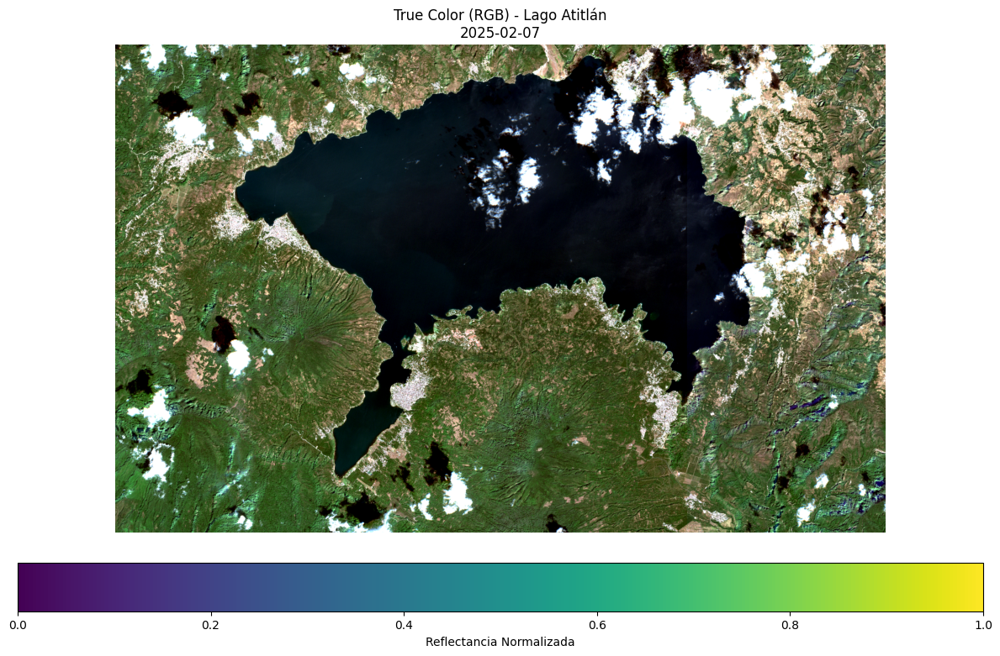

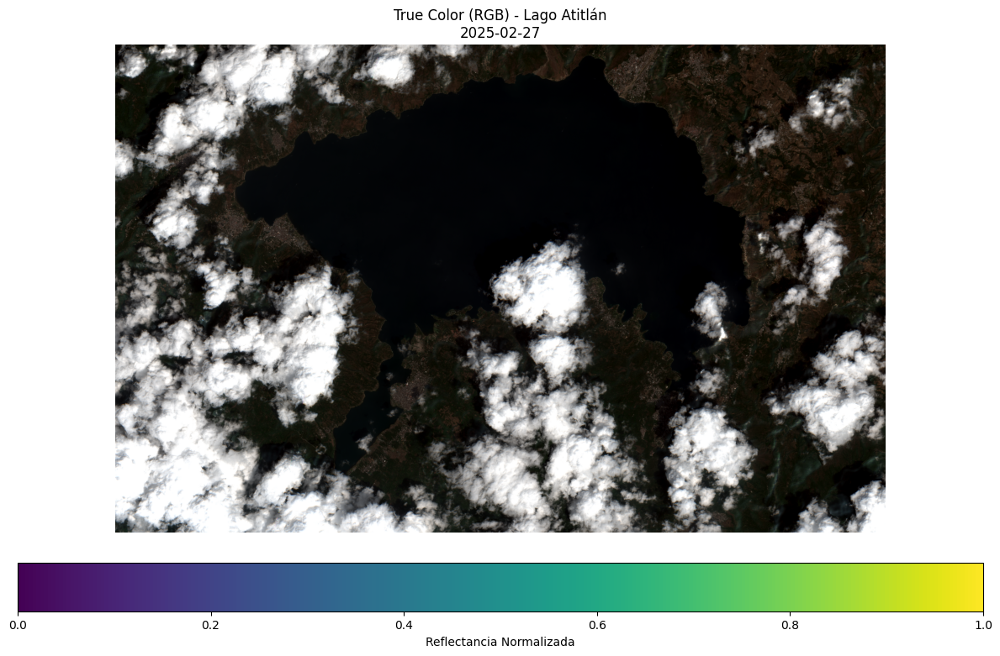

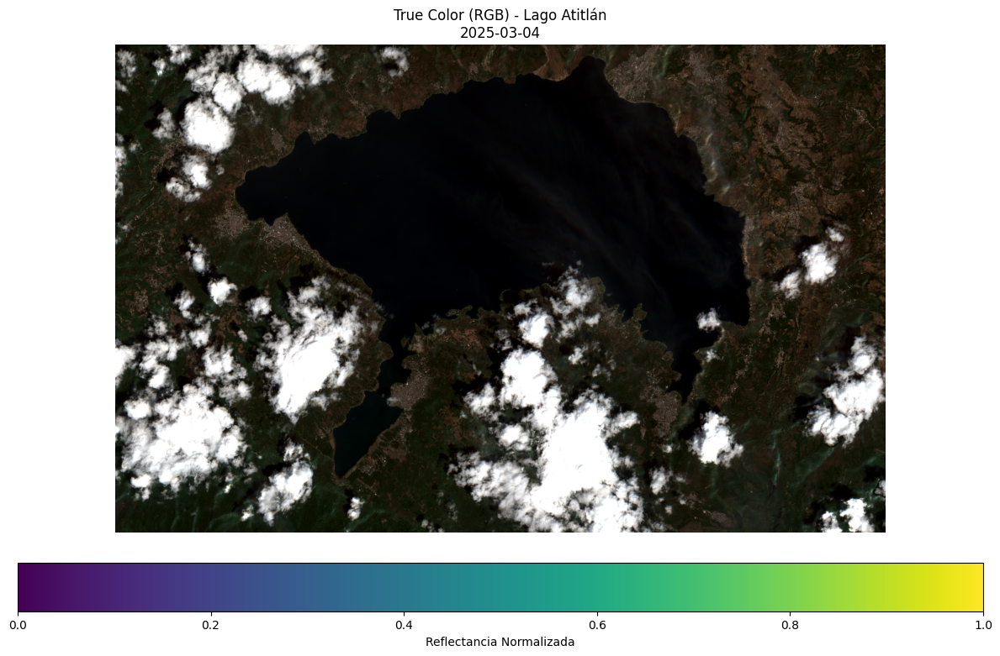

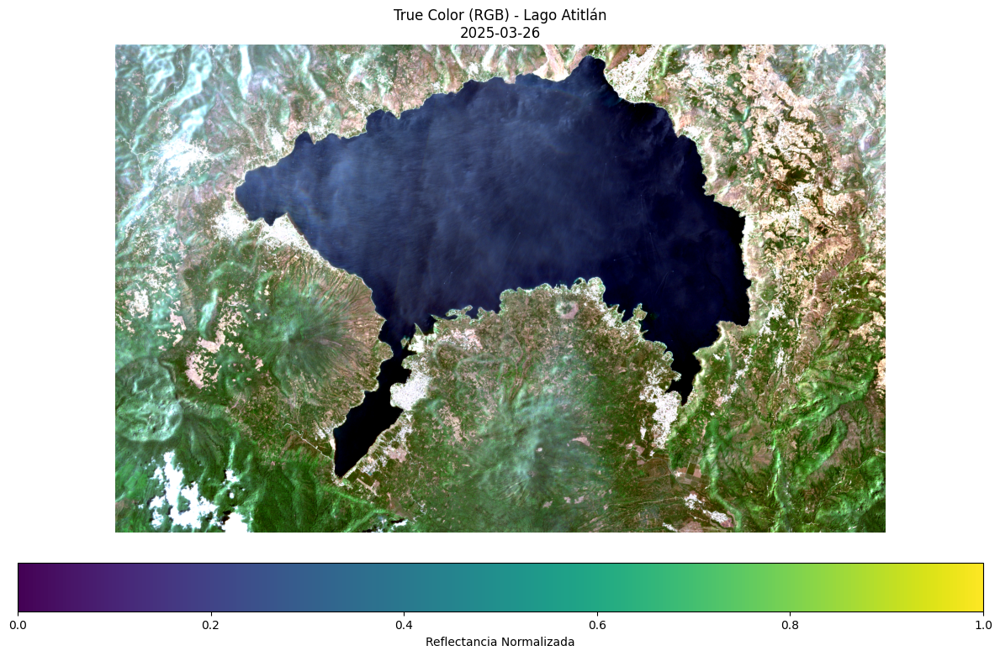

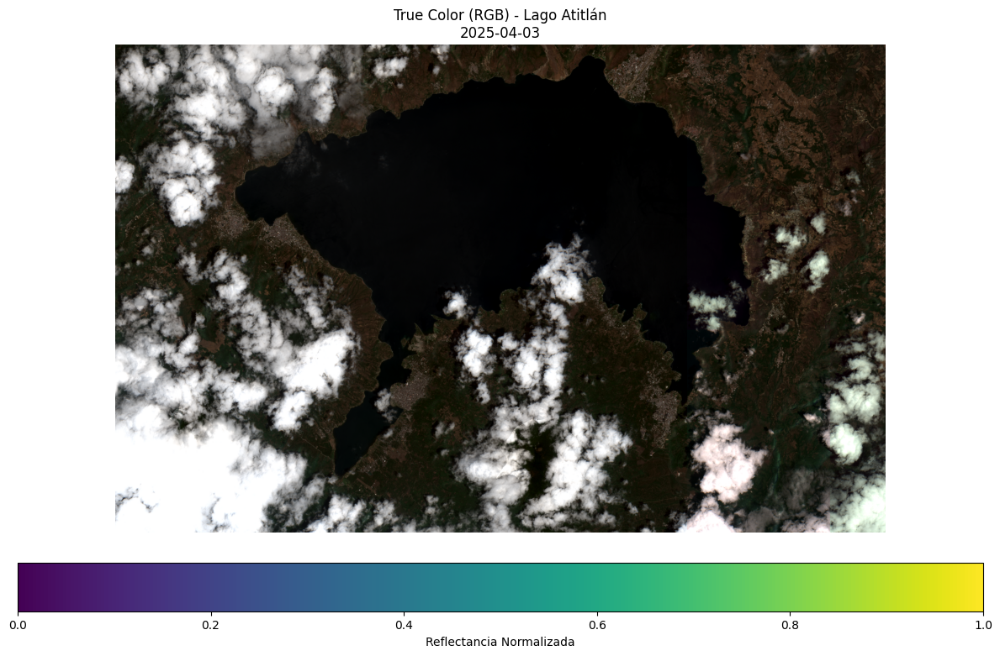

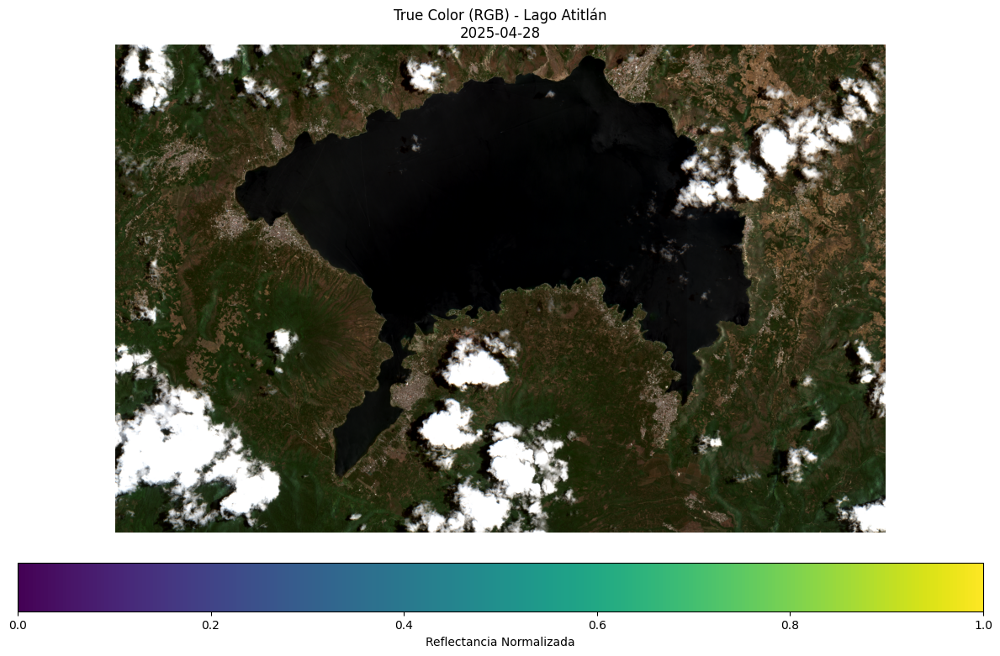

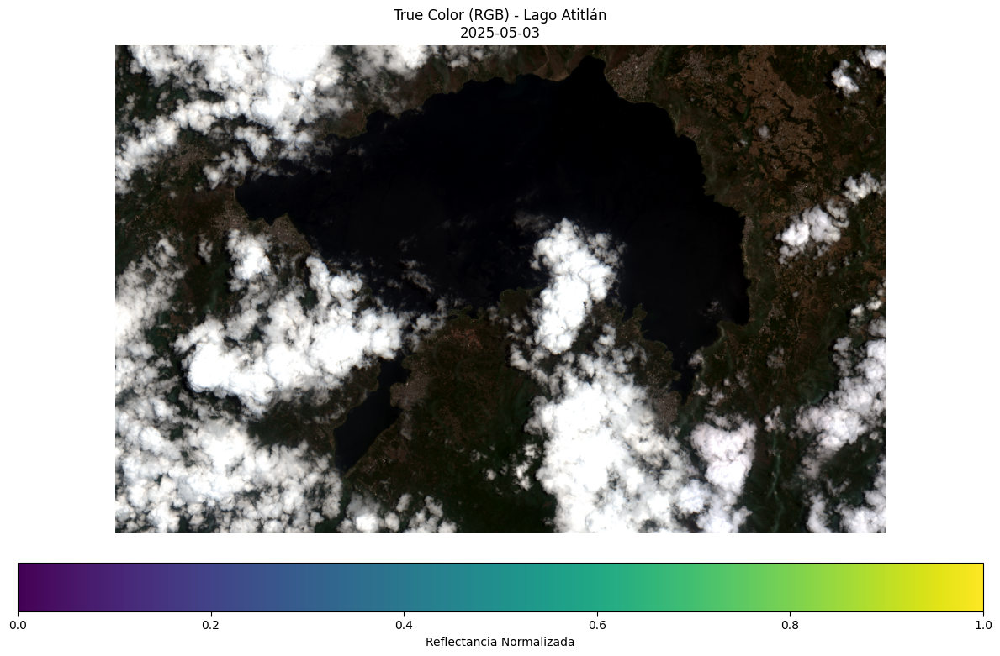

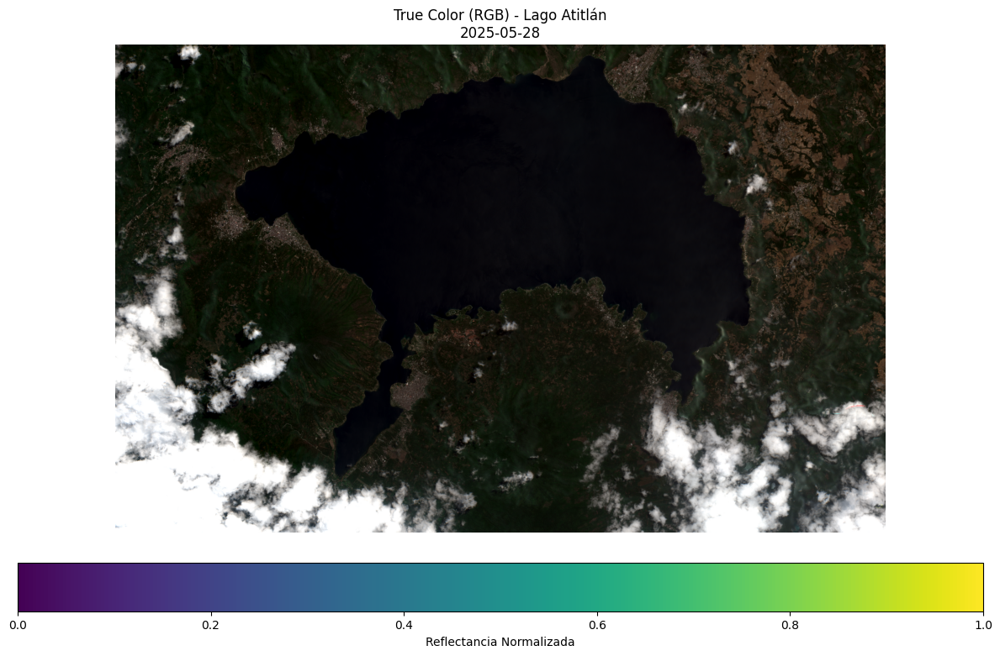

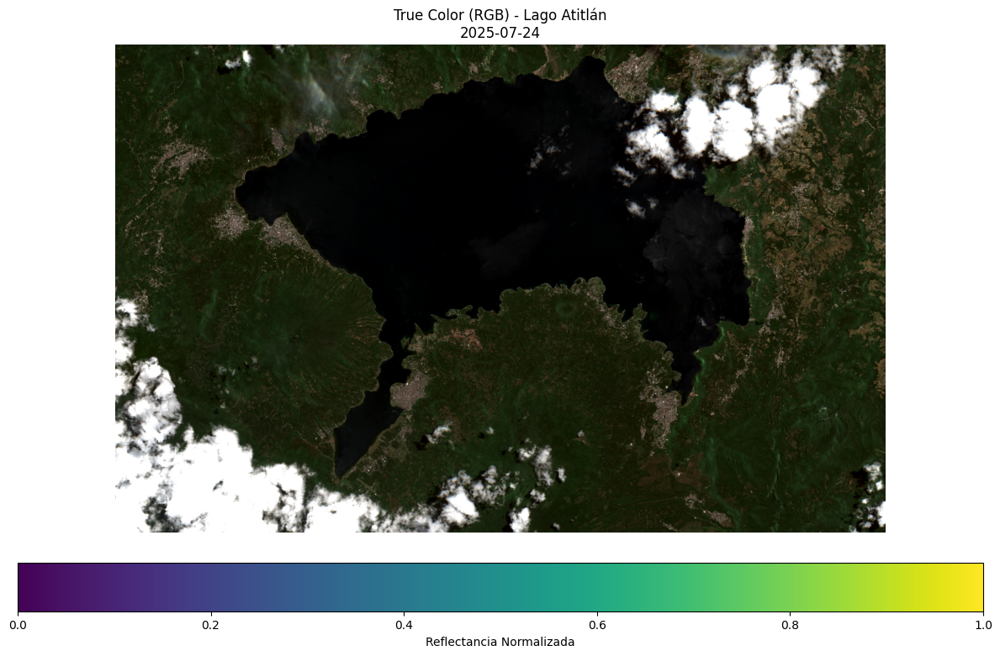

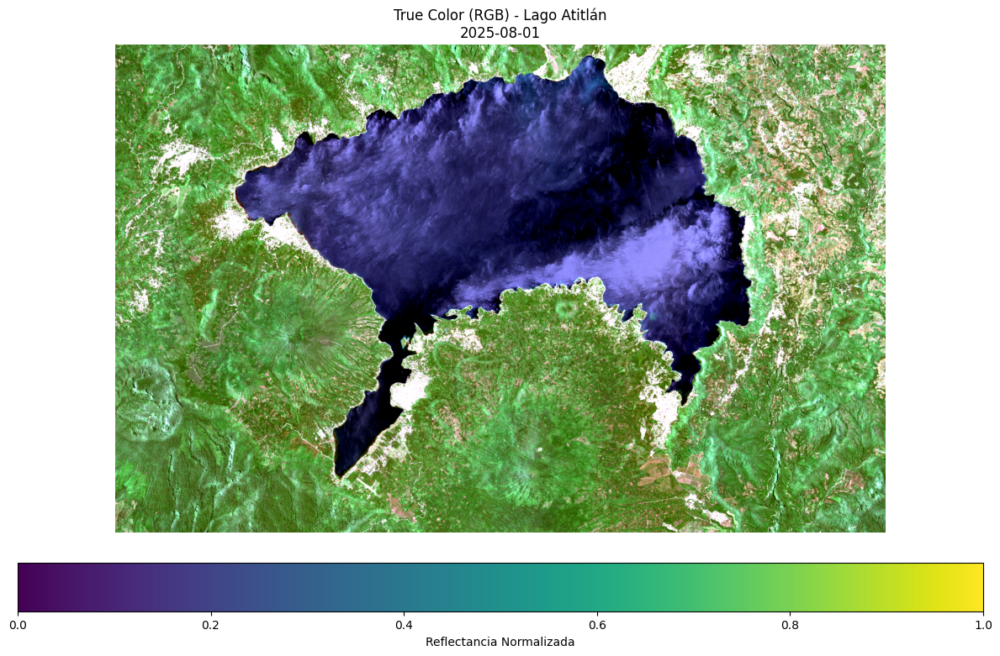

In [ ]:
for fecha in fechas_prueba:
  visualizar_truecolor(fecha, directorio="/content/drive/MyDrive/CC3084_Lab4_Atitlan")

Viendo las imagenes podemos ver que son bastante buenas y de estas la nubosidad no es problema para ninguna. Ahora bien puede que algunas de las imágenes no tengan un procesamiento y análisis de Ciano Bacterias muy eficiente, ya que parecen estar un poco más oscuras. El clima o bien el momento en el que se tomó la imagen desde el satélite puede que influya en los resultados de esta investigación. Habiendo visto que las imágenes son aptas y sin errores mayores, ahora se procede a aplicar las transformaciones para ver el comportamiento de las cianobacterias con el script adaptado a python.

In [ ]:
import warnings

# Aplicar script localmente para todas las fechas
for fecha in fechas_prueba:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        aplicar_script_cyan_local(fecha)

Procesamiento completado: Atitlan_cyan_20250207.tif


Procesamiento completado: Atitlan_cyan_20250227.tif


Procesamiento completado: Atitlan_cyan_20250304.tif


Procesamiento completado: Atitlan_cyan_20250326.tif


Procesamiento completado: Atitlan_cyan_20250403.tif


Procesamiento completado: Atitlan_cyan_20250428.tif


Procesamiento completado: Atitlan_cyan_20250503.tif


Procesamiento completado: Atitlan_cyan_20250528.tif


Procesamiento completado: Atitlan_cyan_20250724.tif
Procesamiento completado: Atitlan_cyan_20250801.tif


In [ ]:
#5 carga de los archivos guardados y guardarlos como un diccionario de arreglos

def cargar_datos_cianobacterias(fechas):
    """Carga todos los datos de cianobacterias en un diccionario de arrays"""
    datos = {}
    for fecha in fechas:
        archivo = f"Atitlan_cyan_{fecha.replace('-','')}.tif"
        with rasterio.open(archivo) as src:
            datos[fecha] = {
                'array': src.read(1),
                'metadata': src.meta
            }
    return datos

# Cargar todos los datos
datos_cian = cargar_datos_cianobacterias(fechas_prueba)

# Analisis temporal

Luego de haber procesado cada una de las imágenes y de guardar la información en distintos arreglos para cade fecha, se puede realizar un análisis del comportamiento de la cianobacteria en el Lago de Atitlan en los últimos meses. Obviamente no tenemos todas las fechas de cada día, más que todo por temas tiempo, pero si tenemos distintos ejemplos de los últimos meses. Para poder analizar primero la cantidad de bacterias, se realiza un índice de cianobacterias y luego se grafica dicho índice en el tiempo.

In [ ]:
#6.1 calcular indice promedio de cianobacteria por lago y fecha

def calcular_promedio_por_fecha(datos_cian):
    promedios = {}
    for fecha, data in datos_cian.items():
        arr = data['array']
        # Excluir valores cero (no agua) y calcular promedio
        valores_cian = arr[arr > 0]
        promedios[fecha] = np.mean(valores_cian) if len(valores_cian) > 0 else 0
    return promedios

promedios_attilan = calcular_promedio_por_fecha(datos_cian)

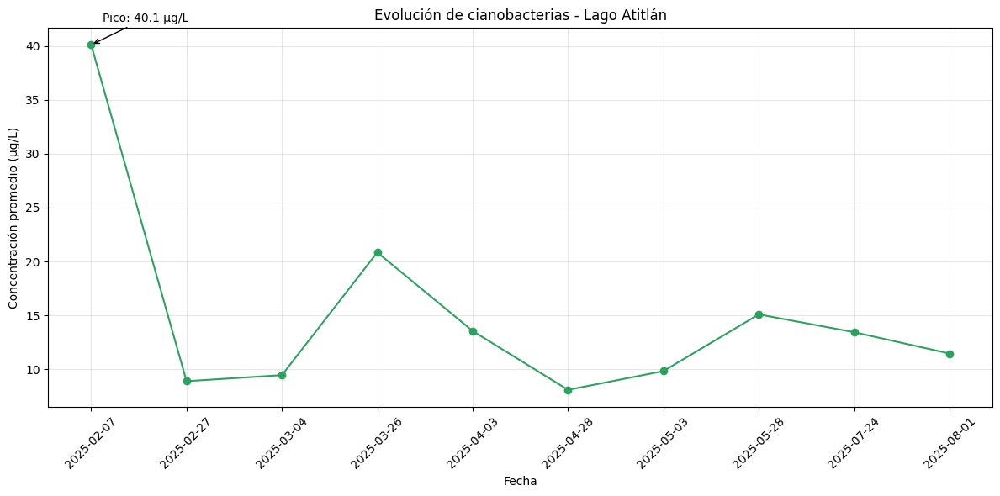

In [ ]:
def graficar_evolucion_temporal(promedios, titulo):
    fechas = sorted(promedios.keys())
    valores = [promedios[f] for f in fechas]

    plt.figure(figsize=(12, 6))
    plt.plot(fechas, valores, marker='o', linestyle='-', color='#2ca25f')

    # Formateo
    plt.title(f"Evolución de cianobacterias - {titulo}")
    plt.ylabel("Concentración promedio (µg/L)")
    plt.xlabel("Fecha")
    plt.xticks(rotation=45)
    plt.grid(True, alpha=0.3)

    # Identificar picos
    max_val = max(valores)
    if max_val > 10:  # Umbral para floración significativa
        idx_max = valores.index(max_val)
        plt.annotate(f'Pico: {max_val:.1f} µg/L',
                     xy=(fechas[idx_max], max_val),
                     xytext=(10, 20), textcoords='offset points',
                     arrowprops=dict(arrowstyle='->'))

    plt.tight_layout()
    plt.savefig(f"evolucion_temporal_{titulo.lower()}.png", dpi=150)
    plt.show()

graficar_evolucion_temporal(promedios_attilan, "Lago Atitlán")

# Fechas críticas

In [ ]:
def identificar_fechas_criticas(promedios, umbral=11):
    fechas_criticas = []
    for fecha, valor in promedios.items():
        if valor > umbral:
            fechas_criticas.append((fecha, valor))
    return sorted(fechas_criticas, key=lambda x: x[1], reverse=True)

fechas_criticas_attilan = identificar_fechas_criticas(promedios_attilan)
print("Fechas críticas en Atitlán:", fechas_criticas_attilan)

Fechas críticas en Atitlán: [('2025-02-07', np.float32(40.10874)), ('2025-03-26', np.float32(20.846922)), ('2025-05-28', np.float32(15.091695)), ('2025-04-03', np.float32(13.55244)), ('2025-07-24', np.float32(13.440505)), ('2025-08-01', np.float32(11.460786))]


Viendo la gráfica y obteniendo los valores más altos dentro de la misma, podemos ver que hay específicamente 3 picos con mayor índice de cianobacteria. Siendo el primero justo en la primera imagen con un índice de 40.11 ug/L en el 7-02-2025. El segundo valor más alto es de 20.87 en en el 26 de abril y el tercero es de 15.09 en el 5 28 de mayo. El comportamiento es algo inusual, ya que de un día de un mes a otro pareciera que la cantidad de bacteria dimsinuye y vuelve a aumentar. Esto podría deberse tal vez a las imagenes que presentaban más oscuridad, puede que no se estén detectando del todo por la calidad de la imagen. Pero aún así se puede ver que si hay contaminación en el lago. Para ver esto con mayor claridad, es posible mostrar la presencia de cianobacterias directamente sobre el mapa de cada uno de los días.

# Analisis espacial

In [ ]:
def visualizar_resultados(fecha):
    """Visualiza los resultados del análisis"""
    input_file = f"Atitlan_cyan_{fecha.replace('-','')}.tif"

    if not os.path.exists(input_file):
        print(f"Archivo {input_file} no encontrado")
        return

    with rasterio.open(input_file) as src:
        chl = src.read(1)
        meta = src.meta

    # Crear máscara para valores fuera del agua
    chl_masked = np.ma.masked_where(chl <= 0, chl)

    # Visualización
    plt.figure(figsize=(12, 8))
    im = plt.imshow(chl_masked, cmap='RdYlGn_r', vmin=0, vmax=30)

    # Barra de color con categorías
    cbar = plt.colorbar(im, label='Concentración de Clorofila-a (µg/L)')
    cbar.set_ticks([0, 5, 10, 20, 30])
    cbar.set_ticklabels(['<5 (Baja)', '5-10 (Moderada)', '10-20 (Alta)', '20-30 (Muy alta)', '>30 (Extrema)'])

    plt.title(f"Mapa de Cianobacterias - Lago Atitlán\n{fecha}")
    plt.axis('off')

    # Guardar imagen
    plt.savefig(f"Atitlan_cyan_map_{fecha.replace('-','')}.png", bbox_inches='tight', dpi=150)
    plt.show()



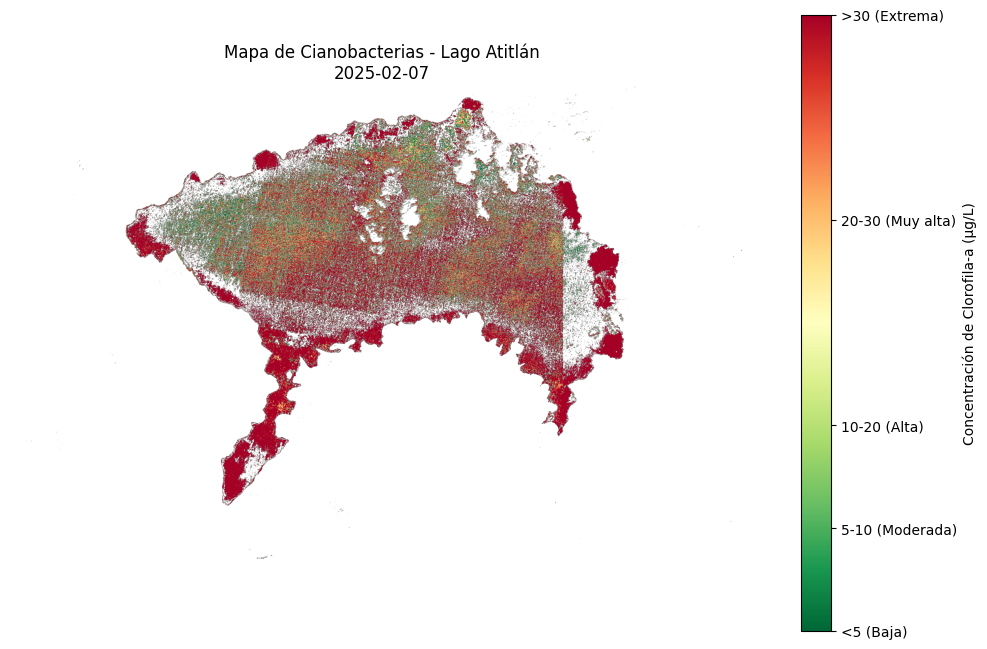

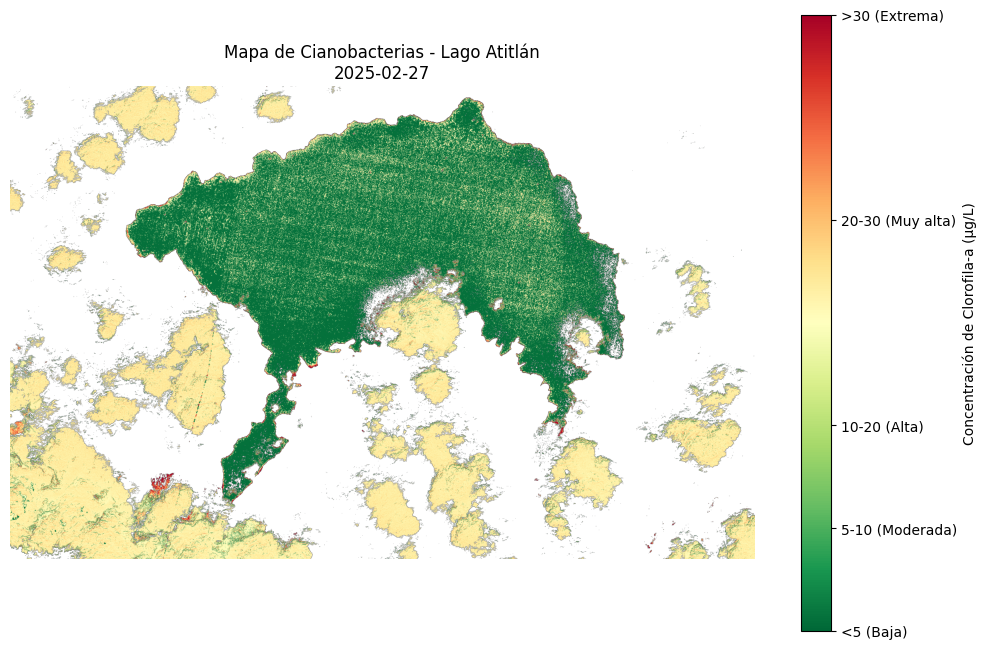

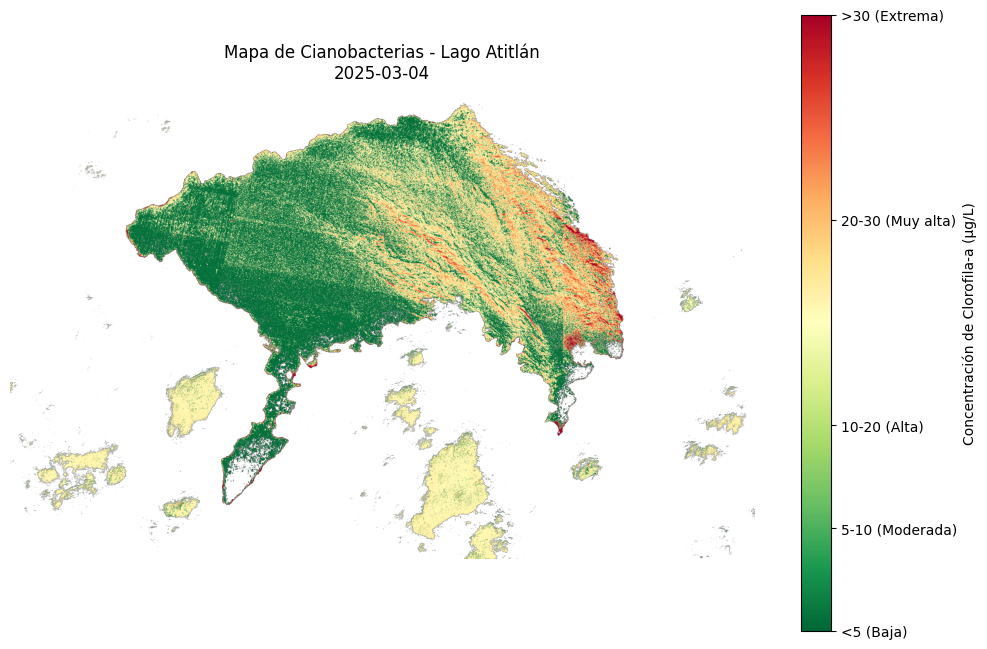

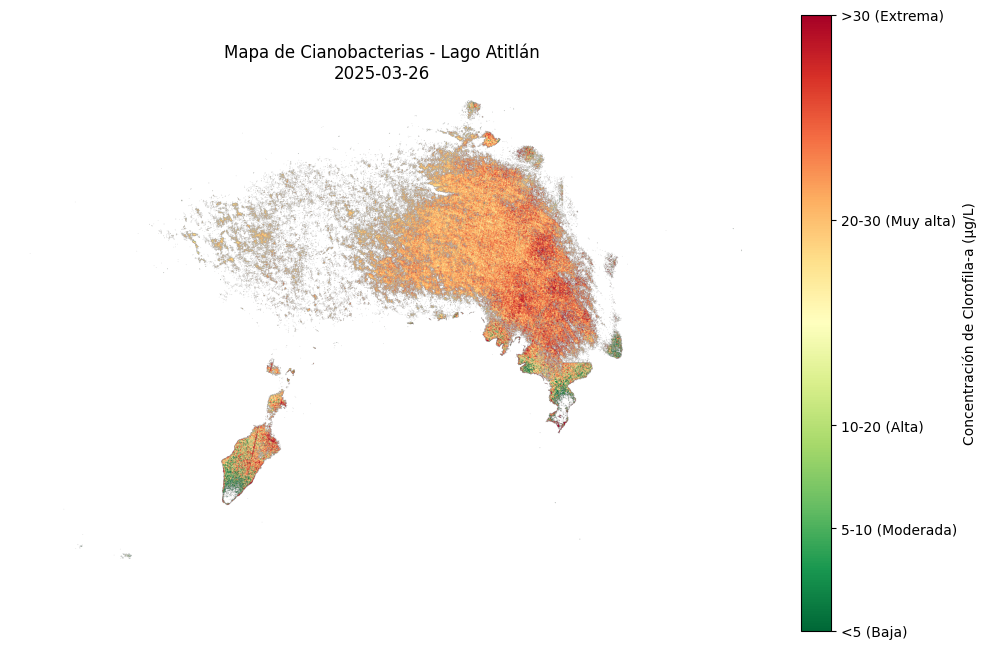

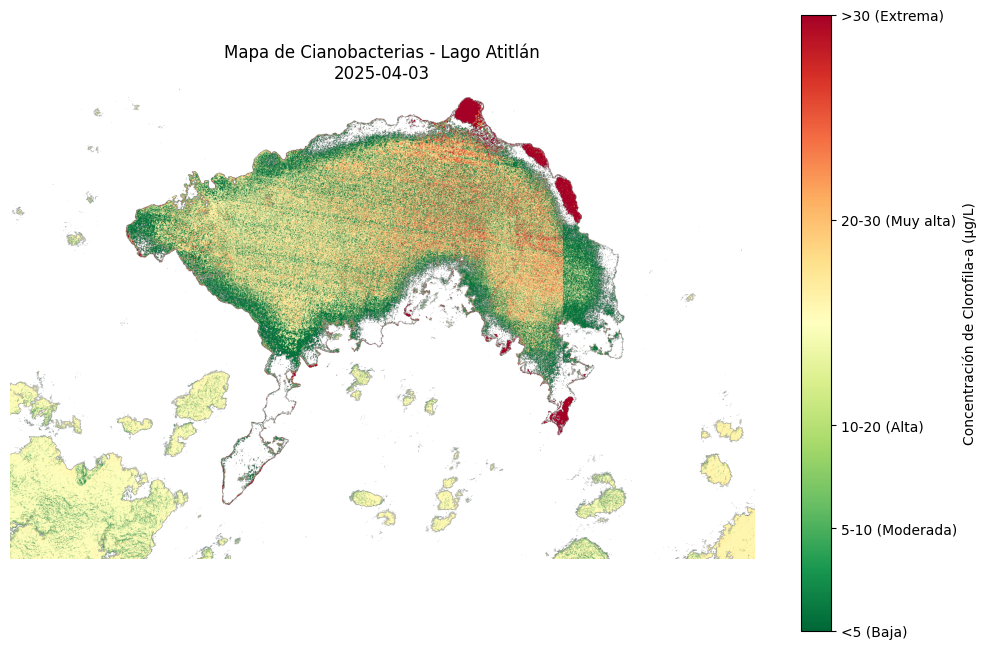

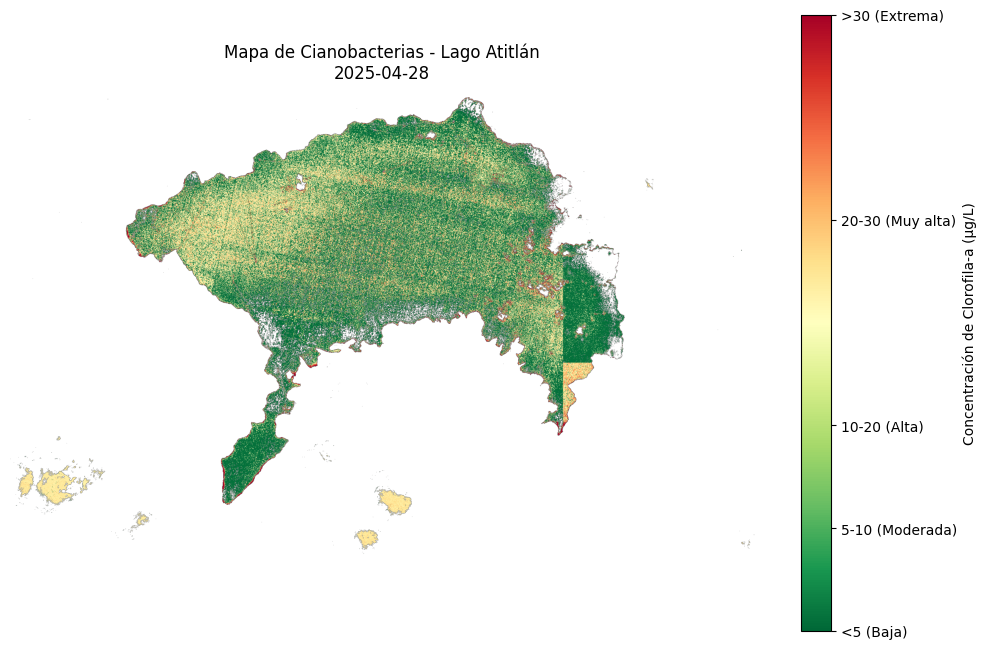

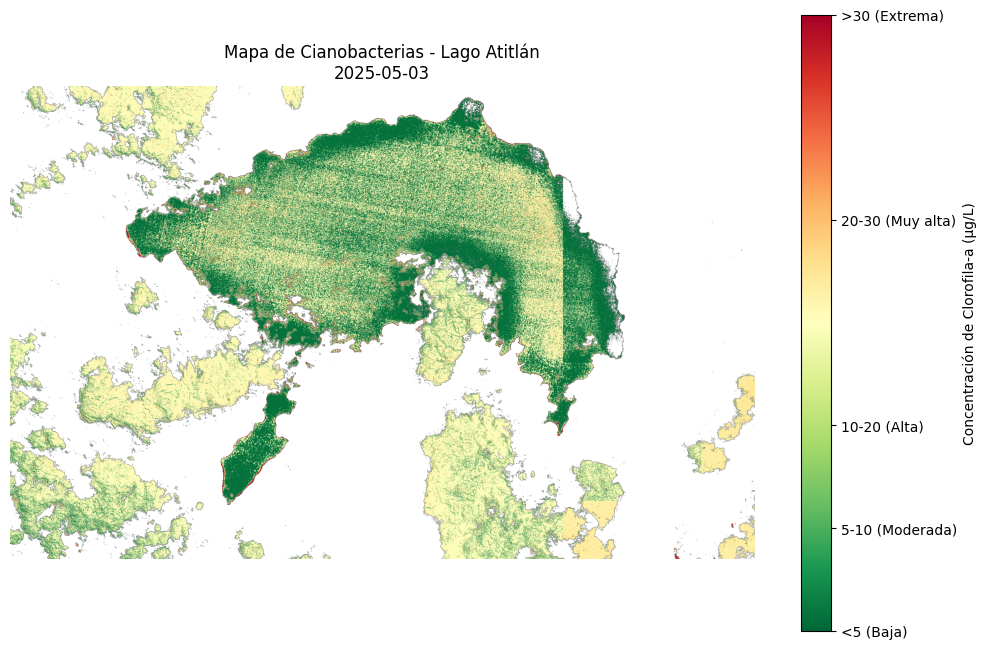

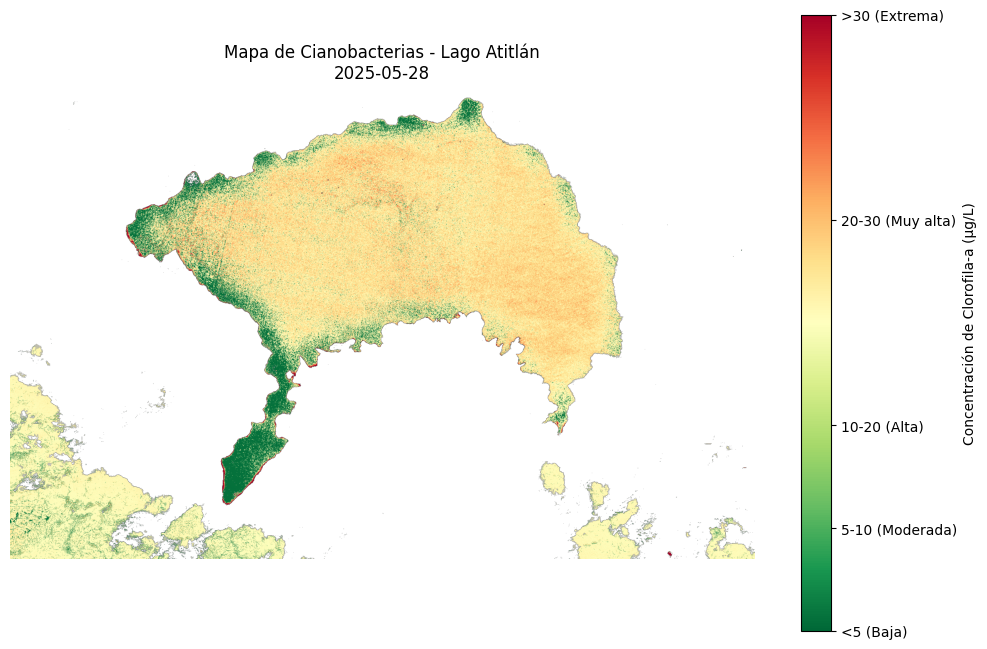

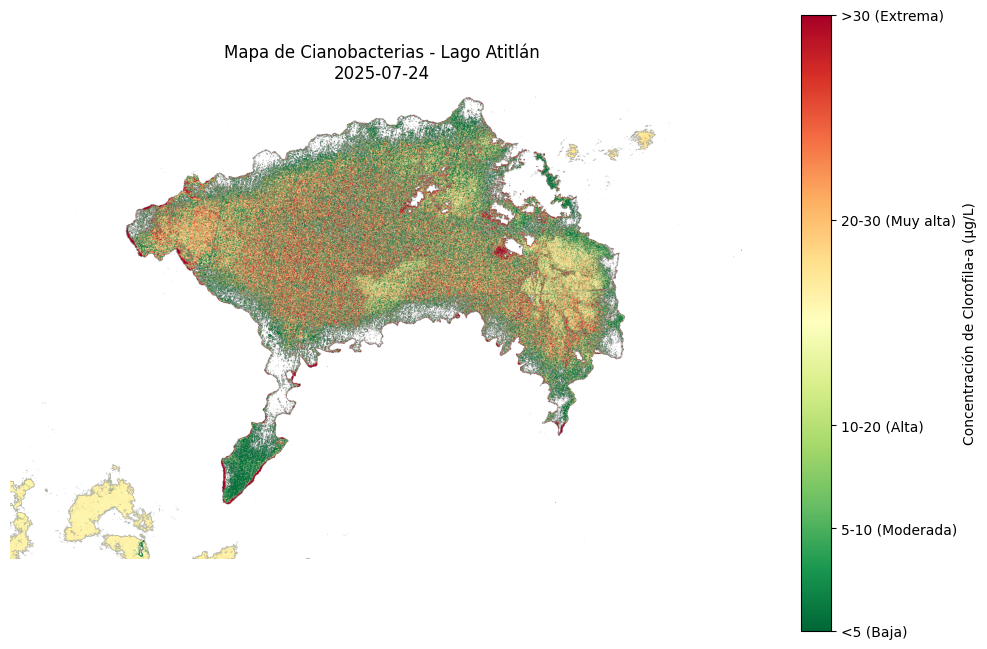

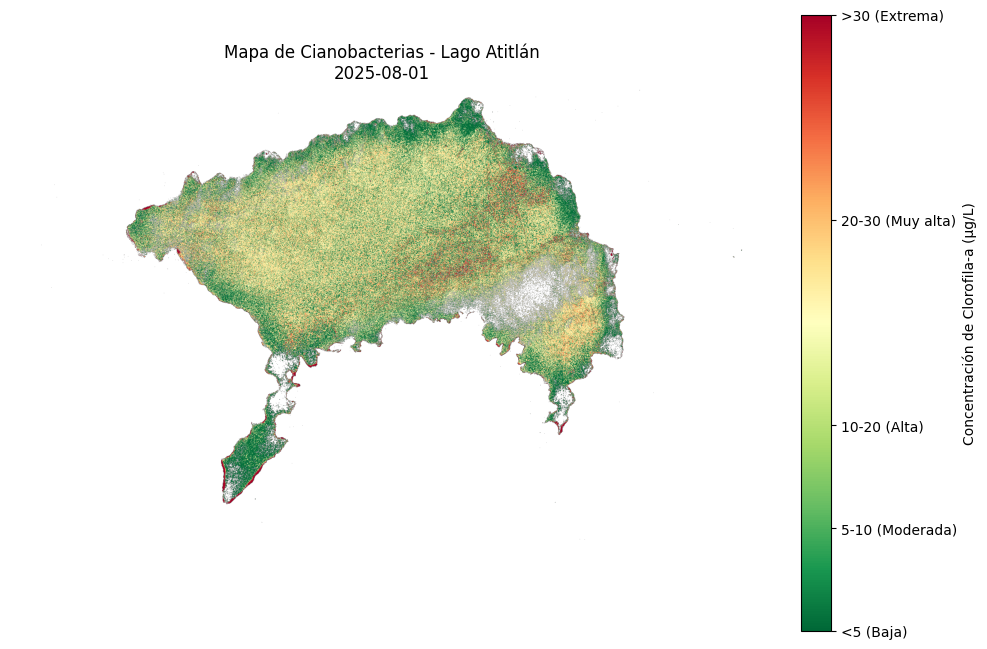

In [ ]:
# Visualizar resultados para todas las fechas
for fecha in fechas_prueba:
    visualizar_resultados(fecha)

Nuevamente se nos confirma la presencia de cianobacteria dentro de el Lago de Atitlan. Los mapas con los colores para representar la presencia de suciedad. Las imágenes son congruentes con lo analizado en la gr+afica de índice de cianobacteria, pero la diferencia es que ahora no solo conocemos los valores altos, sino que también específicamente en que partes del lago se encuentra la cianobacteria. Curiosamente, en la mayoría de los casos la mayor concentración se puede ver en los bordes del lago.

Entrando en temas un poco más allegados a lo social que a lo estadístico, es bastante sabido que las personas que viven cerca de ríos y lagos en Guatemala tienden a realizar distintas actividades en las orillas de los lagos. Ya sean activiades recreativas o incluso las personas puden llegar a bañarse, lavar ropa tirar basura y demás. Esos pueden ser algunos motivos por los cuales se puede estar acelarando la producción de bacterias. Aunque la producción de cianobacterias podría darse por otros motivos podemos analizarlo con el NVDI y NDWI y ver si alguno de estoas factores influye en la presencia de bacterias.

# Correlación índices (NDVI y NDWI)

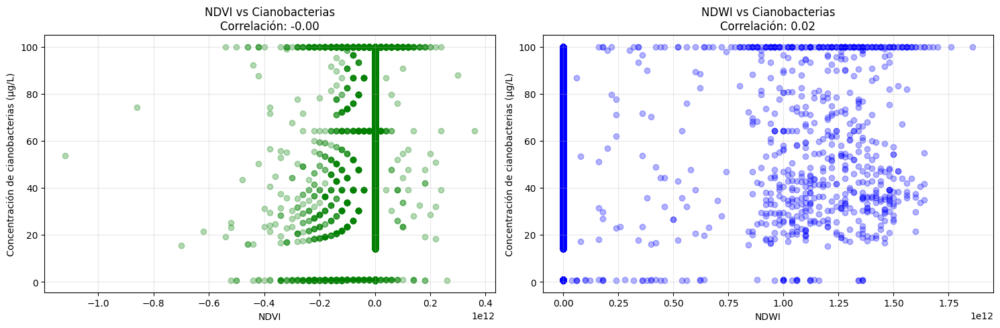

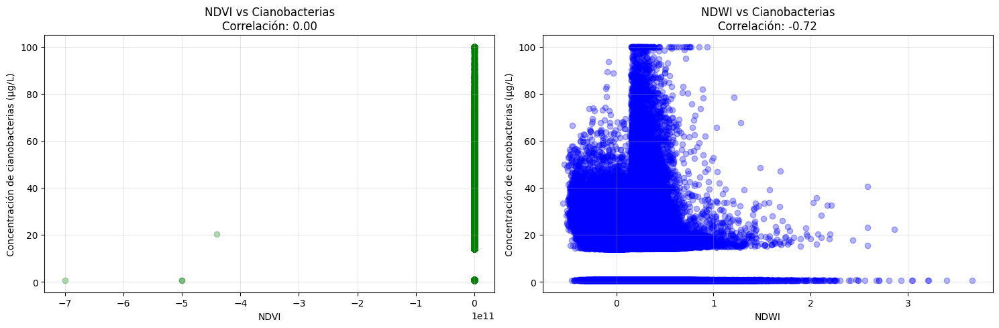

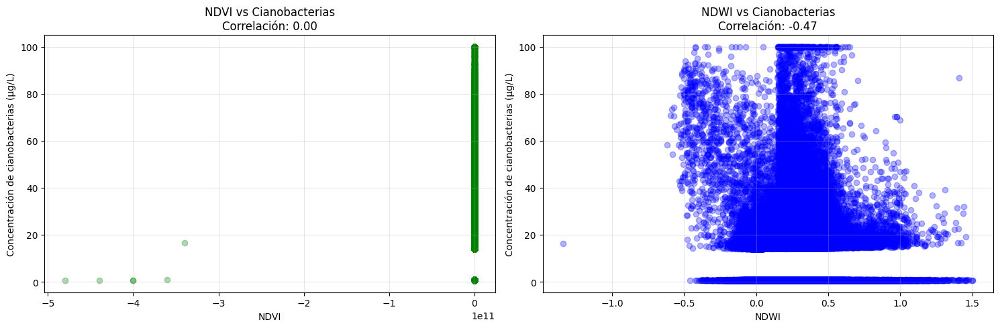

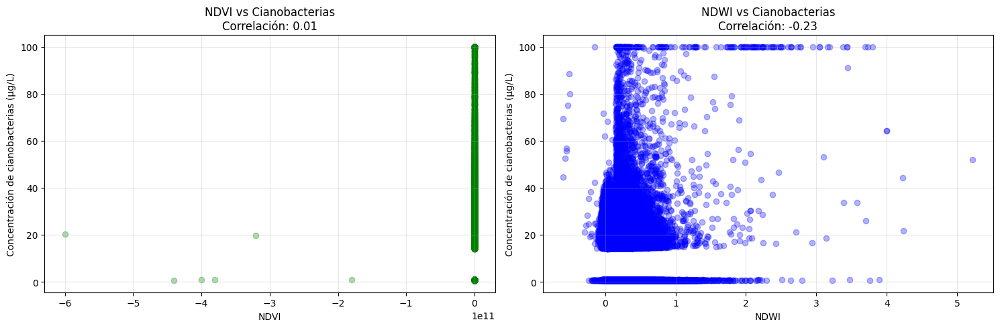

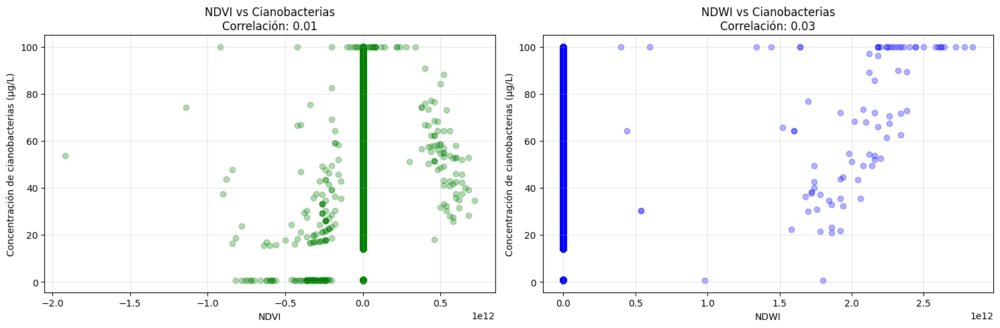

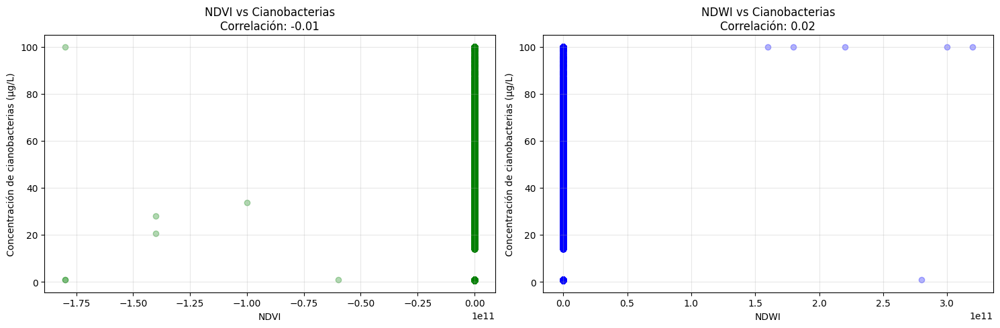

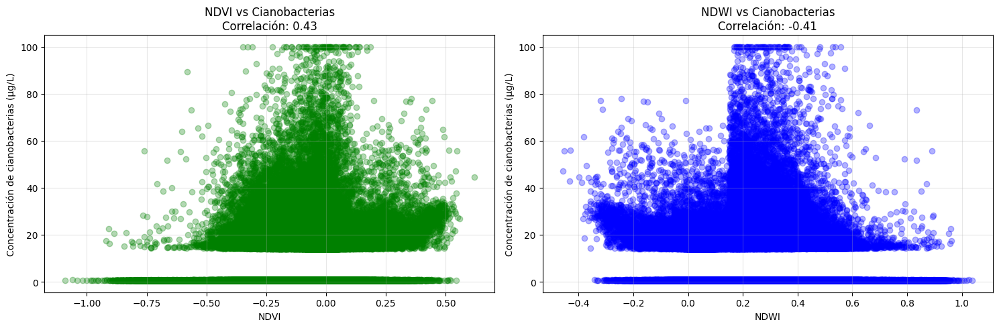

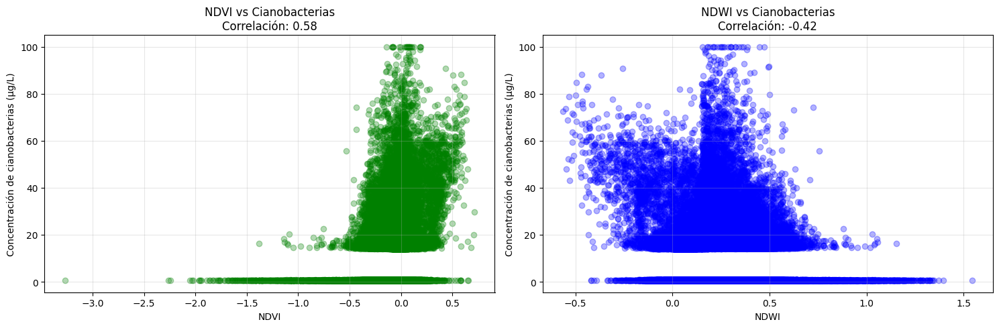

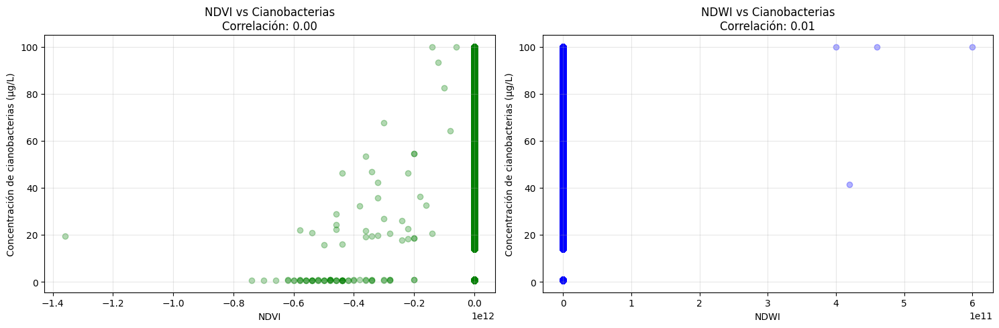

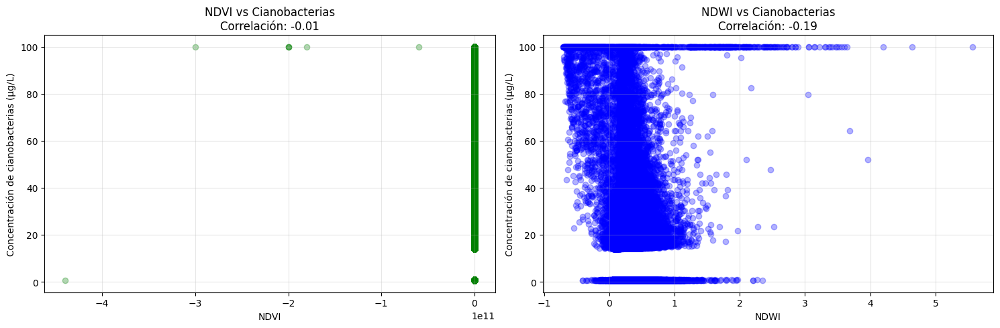


Resumen de correlaciones:
        fecha  corr_ndvi  corr_ndwi  n_pixeles
0  2025-02-07  -0.002785   0.016702     829584
1  2025-02-27   0.000687  -0.715713    2016627
2  2025-03-04   0.001541  -0.468208    1306015
3  2025-03-26   0.007207  -0.230590     460790
4  2025-04-03   0.010512   0.032718    1342361
5  2025-04-28  -0.005098   0.016643    1130556
6  2025-05-03   0.434255  -0.409869    1875740
7  2025-05-28   0.583035  -0.419189    1531172
8  2025-07-24   0.001959   0.010648    1065704
9  2025-08-01  -0.013686  -0.189480    1083833


In [ ]:
def analizar_correlaciones(fecha, datos_cian, plot=True):
    """
    Analiza correlaciones entre índices espectrales y concentración de cianobacterias

    Parámetros:
        fecha: str - Fecha a analizar (formato 'YYYY-MM-DD')
        datos_cian: dict - Diccionario con los datos de cianobacterias
        plot: bool - Si True, genera gráficos de dispersión

    Retorna:
        dict - Diccionario con resultados de correlación
    """
    try:
        # 1. Cargar datos
        with rasterio.open(f"Atitlan_bands_{fecha.replace('-','')}.tif") as src:
            b3 = src.read(2)  # Green (B03)
            b4 = src.read(3)  # Red (B04)
            b8 = src.read(5)  # NIR (B08)

        cian_array = datos_cian[fecha]['array']
        mask_agua = cian_array > 0

        # 2. Calcular índices
        ndvi = (b8 - b4) / (b8 + b4 + 1e-10)
        ndwi = (b3 - b8) / (b3 + b8 + 1e-10)

        # 3. Preparar datos para correlación (solo áreas con agua)
        cian_vals = cian_array[mask_agua].flatten()
        ndvi_vals = ndvi[mask_agua].flatten()
        ndwi_vals = ndwi[mask_agua].flatten()

        # 4. Calcular correlaciones
        corr_ndvi = np.corrcoef(cian_vals, ndvi_vals)[0,1]
        corr_ndwi = np.corrcoef(cian_vals, ndwi_vals)[0,1]

        # 5. Visualización (si se solicita)
        if plot:
            plt.figure(figsize=(15, 5))

            # Gráfico NDVI vs Cianobacterias
            plt.subplot(1, 2, 1)
            plt.scatter(ndvi_vals, cian_vals, alpha=0.3, color='green')
            plt.xlabel('NDVI')
            plt.ylabel('Concentración de cianobacterias (µg/L)')
            plt.title(f'NDVI vs Cianobacterias\nCorrelación: {corr_ndvi:.2f}')
            plt.grid(True, alpha=0.3)

            # Gráfico NDWI vs Cianobacterias
            plt.subplot(1, 2, 2)
            plt.scatter(ndwi_vals, cian_vals, alpha=0.3, color='blue')
            plt.xlabel('NDWI')
            plt.ylabel('Concentración de cianobacterias (µg/L)')
            plt.title(f'NDWI vs Cianobacterias\nCorrelación: {corr_ndwi:.2f}')
            plt.grid(True, alpha=0.3)

            plt.tight_layout()
            plt.savefig(f"correlaciones_{fecha.replace('-','')}.png", dpi=150)
            plt.show()

        # 6. Retornar resultados
        return {
            'fecha': fecha,
            'corr_ndvi': corr_ndvi,
            'corr_ndwi': corr_ndwi,
            'n_pixeles': len(cian_vals)
        }

    except Exception as e:
        print(f"Error analizando {fecha}: {str(e)}")
        return None

# Ejemplo de uso para todas las fechas
resultados_correlacion = []
for fecha in fechas_prueba:
    resultados = analizar_correlaciones(fecha, datos_cian)
    if resultados:
        resultados_correlacion.append(resultados)

# Convertir a DataFrame para mejor visualización
import pandas as pd
df_correlaciones = pd.DataFrame(resultados_correlacion)
print("\nResumen de correlaciones:")
print(df_correlaciones)

Los resultados muestran una relación interesante entre los índices NDVI y NDWI con la presencia de cianobacterias en el Lago de Atitlán. Aunque no todas las fechas presentaron correlaciones fuertes, hay patrones claros: en mayo, cuando el NDVI mostró valores altos (0.43 y 0.58) y el NDWI valores negativos (-0.41 y -0.42), se confirmó una mayor actividad de cianobacterias. Esto tiene sentido porque el NDVI, al detectar "vegetación", capta las floraciones densas, mientras que el NDWI, al medir la pureza del agua, disminuye cuando hay contaminación.

Sin embargo, algunas imágenes no mostraron correlaciones significativas, posiblemente por problemas de calidad—en el true color, varias se veían oscuras o con poca claridad, lo que pudo afectar los cálculos. Aun así, los datos más fuertes, como los de mayo respaldan lo que ya sospechábamos. En general la cianobacteria suele concentrarse más en las orillas del lago, justo donde la actividad humana es más intensa.

In [4]:
import warnings
warnings.filterwarnings("ignore")

import logging
logging.getLogger('rasterio').setLevel(logging.ERROR)


# Lago de Amatitlán

Primero realizamos las importaciones necesarias.

In [5]:

import rasterio
import numpy as np
import matplotlib.pyplot as plt
from datetime import date
import openeo

Seguidamente se debe establecer conexión con el sitio de Copernicus, para lo cual se necestiaba tener una cuenta registrada.

In [6]:
connection = openeo.connect("https://openeo.dataspace.copernicus.eu").authenticate_oidc()

Visit https://identity.dataspace.copernicus.eu/auth/realms/CDSE/device?user_code=PWIM-PXRU 📋 to authenticate.

✅ Authorized successfully

Authenticated using device code flow.


Se deben proveer las coordenadas del área que se desea estudiar. En este caso Lago de Amatitlán.

In [9]:
import json

with open("/Lago_Amatitlan.geojson") as f:
    fc = json.load(f)

coords = fc["features"][0]["geometry"]["coordinates"][0]


lons, lats = zip(*coords)
spatial_extent = {
    "west": min(lons),
    "south": min(lats),
    "east": max(lons),
    "north": max(lats)
}


Establecemos los rangos de fecha sobre los cuales queremos trabajar. El PDF menciona 6, pero se permitieron colo 3 por cuestiones de tiempo y recursos.

In [10]:
periodos = {
    "mayo":   ("2025-05-01", "2025-05-31"),
    "junio":  ("2025-06-01", "2025-06-30"),
    "julio":  ("2025-07-01", "2025-07-31"),
}


Descargamos los archivos con las configuraciones en el chunk.

In [11]:
for mes, (fecha_inicio, fecha_fin) in periodos.items():

    cube = (
        connection
        .load_collection(
            "SENTINEL2_L2A",
            spatial_extent=spatial_extent,
            temporal_extent=[fecha_inicio, fecha_fin]
        )
        .filter_bands(["B04", "B08"])
    )

    salida = f"amatitlan_{mes}_2025.tif"
    cube.download(salida)
    print("Descargado:", salida)


Descargado: amatitlan_mayo_2025.tif
Descargado: amatitlan_junio_2025.tif
Descargado: amatitlan_julio_2025.tif


Hacemos una visualización para cada banda del mes de mayo 2025.

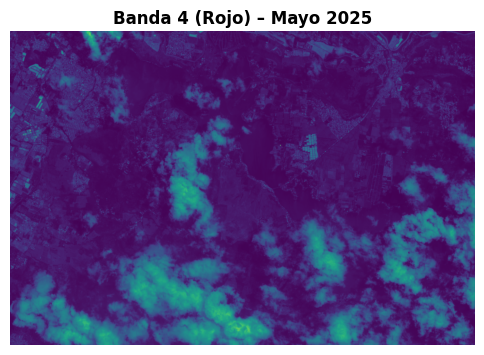

In [13]:
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

with rasterio.open("amatitlan_mayo_2025.tif") as src:
    fig, ax = plt.subplots(figsize=(6, 6))
    show(src.read(1), ax=ax, title="Banda 4 (Rojo) – Mayo 2025")
    plt.axis("off")
    plt.show()


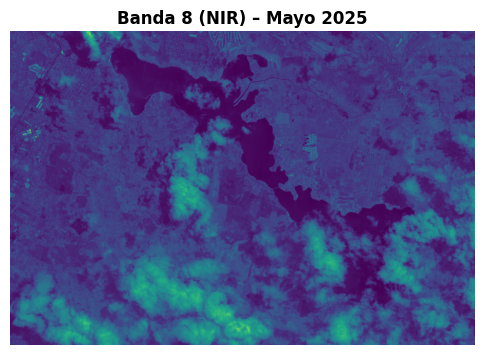

In [14]:
with rasterio.open("amatitlan_mayo_2025.tif") as src:
    fig, ax = plt.subplots(figsize=(6, 6))
    show(src.read(2), ax=ax, title="Banda 8 (NIR) – Mayo 2025")
    plt.axis("off")
    plt.show()


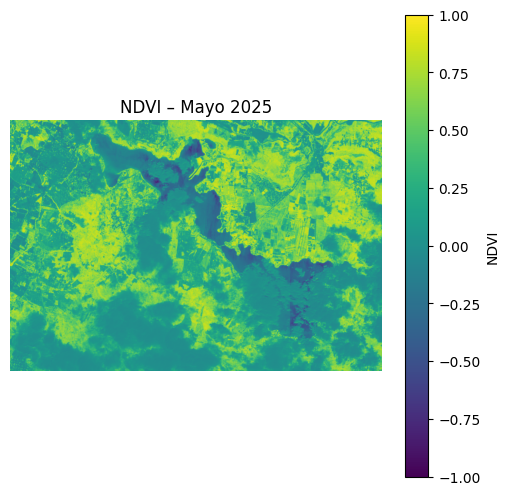

In [15]:
#mayo 2025
with rasterio.open("amatitlan_mayo_2025.tif") as src:
    red = src.read(1).astype("float32")
    nir = src.read(2).astype("float32")
    ndvi = (nir - red) / (nir + red + 1e-8)

    fig, ax = plt.subplots(figsize=(6, 6))
    im = ax.imshow(ndvi, vmin=-1, vmax=1)
    ax.set_title("NDVI – Mayo 2025")
    ax.axis("off")
    fig.colorbar(im, ax=ax, label="NDVI")
    plt.show()


Necesitamos más Bandas para hacer el estudio correspondiente de la cianobacteria, así que procedemos a descargarlos. Además, usamos fechas específicas provista por Lynette.

In [22]:
from datetime import datetime, timedelta
fechas_cyano = [
    "2025-02-07", "2025-02-10", "2025-02-25", "2025-02-27",
    "2025-03-02", "2025-03-04", "2025-03-07", "2025-03-09",
    "2025-03-12", "2025-03-14", "2025-03-19", "2025-03-22",
    "2025-03-24", "2025-03-26", "2025-04-03", "2025-04-11",
    "2025-04-13", "2025-04-15", "2025-04-16", "2025-04-18",
    "2025-04-28", "2025-05-03", "2025-05-13", "2025-05-28",
    "2025-07-10", "2025-07-17", "2025-07-20", "2025-07-24",
    "2025-08-01"
]
def rango_dias(fecha_str, delta=1):
    fecha = datetime.strptime(fecha_str, "%Y-%m-%d")
    inicio = (fecha - timedelta(days=delta)).strftime("%Y-%m-%d")
    fin = (fecha + timedelta(days=delta)).strftime("%Y-%m-%d")
    return inicio, fin


In [23]:
# Bandas necesarias
bandas = ["B02","B03","B04","B05","B07","B08","B8A","B11","B12"]

for i, fecha in enumerate(fechas_cyano, start=1):
    inicio, fin = rango_dias(fecha, delta=3)
    cube = (
        connection
        .load_collection(
            "SENTINEL2_L2A",
            spatial_extent=spatial_extent,
            temporal_extent=[inicio, fin]
        )
        .filter_bands(bandas)
    )
    salida = f"amatitlan_fecha_{i}_full.tif"
    cube.download(salida)
    print(f"Descargado: {salida}")


Descargado: amatitlan_fecha_1_full.tif
Descargado: amatitlan_fecha_2_full.tif
Descargado: amatitlan_fecha_3_full.tif
Descargado: amatitlan_fecha_4_full.tif
Descargado: amatitlan_fecha_5_full.tif
Descargado: amatitlan_fecha_6_full.tif
Descargado: amatitlan_fecha_7_full.tif
Descargado: amatitlan_fecha_8_full.tif
Descargado: amatitlan_fecha_9_full.tif
Descargado: amatitlan_fecha_10_full.tif
Descargado: amatitlan_fecha_11_full.tif
Descargado: amatitlan_fecha_12_full.tif
Descargado: amatitlan_fecha_13_full.tif
Descargado: amatitlan_fecha_14_full.tif
Descargado: amatitlan_fecha_15_full.tif
Descargado: amatitlan_fecha_16_full.tif
Descargado: amatitlan_fecha_17_full.tif
Descargado: amatitlan_fecha_18_full.tif
Descargado: amatitlan_fecha_19_full.tif
Descargado: amatitlan_fecha_20_full.tif
Descargado: amatitlan_fecha_21_full.tif
Descargado: amatitlan_fecha_22_full.tif
Descargado: amatitlan_fecha_23_full.tif
Descargado: amatitlan_fecha_24_full.tif
Descargado: amatitlan_fecha_25_full.tif
Descargad

Ahora tomamos una imagen satelital del lago y la recortamos para quedarnos con el áreade interés. Se limpian los valores sin información, se ajusta la escala de las bandas y se hacen cálculos para estimar la concentración de clorofila-a en la superficie del agua. A partir de esto se genera un mapa que muestra la distribución espacial de la clorofila-a dentro del lago.

La medición de clorofila-a se utiliza como un indicador indirecto de la presencia y proliferación de cianobacterias. Este pigmento está presente en todos los organismos fotosintéticos, incluidas las cianobacterias, y su concentración aumenta significativamente durante los eventos de floración. Por ello, identificar áreas y fechas con altos niveles de clorofila-a permite detectar y monitorear posibles episodios de crecimiento masivo de cianobacterias en el lago.


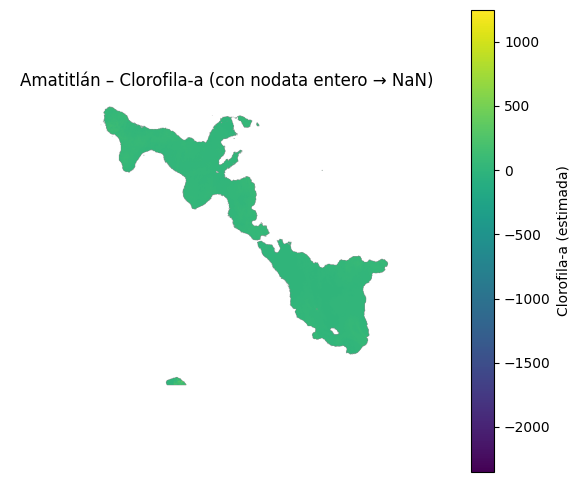

In [24]:
import numpy as np
import rasterio
from rasterio.mask import mask
from rasterio.warp import transform_geom
import matplotlib.pyplot as plt

ruta = "amatitlan_fecha_1_full.tif"

with rasterio.open(ruta) as src:
    geom_wgs84 = fc["features"][0]["geometry"]
    geom_raster = transform_geom("EPSG:4326", src.crs.to_string(), geom_wgs84, precision=6)

    band_dtype = np.dtype(src.dtypes[0])
    int_nodata = src.nodata if (src.nodata is not None and np.issubdtype(band_dtype, np.integer)) else -32768

    data, out_transform = mask(
        src,
        [geom_raster],
        crop=True,
        filled=True,
        nodata=int_nodata,
        indexes=list(range(1, 10))
    )

data = data.astype("float32")
data[data == float(int_nodata)] = np.nan

B02, B03, B04, B05, B07, B08, B8A, B11, B12 = data

if np.nanmedian(B04) > 1.5:
    for arr in (B02, B03, B04, B05, B07, B08, B8A, B11, B12):
        arr /= 10000.0

def safe_div(a, b):
    out = np.full_like(a, np.nan, dtype="float32")
    m = (b != 0) & np.isfinite(a) & np.isfinite(b)
    out[m] = a[m] / b[m]
    return out


MNDWI = safe_div((B03 - B11), (B03 + B11 + 1e-8))
NDWI  = safe_div((B03 - B08), (B03 + B08 + 1e-8))
water = (MNDWI > 0.42) | (NDWI > 0.40)


FAI  = B8A - B04 - (B07 - B04) * ((783 - 665) / (865 - 665))
NDCI = safe_div((B05 - B04), (B05 + B04 + 1e-8))
chl  = 826.57 * NDCI**3 - 176.43 * NDCI**2 + 19 * NDCI + 4.071

chl_masked = np.where(water & (FAI <= 0.08), chl, np.nan)

plt.figure(figsize=(7,6))
im = plt.imshow(chl_masked, cmap="viridis")
plt.colorbar(im, label="Clorofila-a (estimada)")
plt.title("Amatitlán – Clorofila-a (con nodata entero → NaN)")
plt.axis("off")
plt.show()


El mapa muestra como si bien fue posible aislar el contorno del lago, los valores de clorofila-a calculados incluyen cifras negativas y muy altas, lo que indica que el cálculo aún contiene ruido. Por lo que antes de poder interpretar el mapa como indicador de floraciones de cianobacterias se debe aplicar filtros para qudedarse únicamente con concentraciones realistas.


A continuación corregimos el cálculo anterior filtrando el índice NDCI a un rango válido, calculando la clorofila-a y eliminando valores fuera de un rango físico razonable (0 a 500 µg/L). Después aplicamos una máscara para mostrar únicamente las zonas de agua sin vegetación flotante y finalmente se genera un mapa con la distribución filtrada de clorofila-a en el lago.


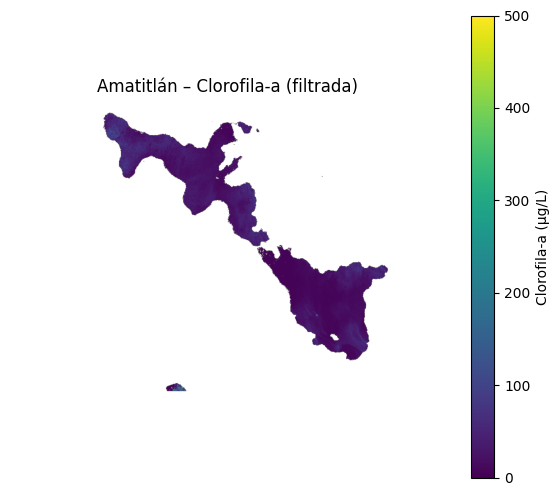

In [25]:
# Limitar NDCI a [-1, 1]
NDCI = np.clip(NDCI, -1, 1)

# Calcular clorofila-a y limpiar
chl = 826.57 * NDCI**3 - 176.43 * NDCI**2 + 19 * NDCI + 4.071
chl[(chl < 0) | (chl > 500)] = np.nan

chl_masked = np.where(water & (FAI <= 0.08), chl, np.nan)


plt.figure(figsize=(7,6))
im = plt.imshow(chl_masked, cmap="viridis", vmin=0, vmax=500)
plt.colorbar(im, label="Clorofila-a (µg/L)")
plt.title("Amatitlán – Clorofila-a (filtrada)")
plt.axis("off")
plt.show()


El mapa muestra la distribución  de clorofila-a en el Lago de Amatitlán con valores filtrados entre 0 y 500 µg/L de esta manera nos aseguramos de eliminar los valores negativos o irreales que aparecían antes.  
Se logran distinguir zonas con concentraciones más elevadas especialmente en el  sur y en algunos puntos aislados, lo que sugiere áreas con mayor probabilidad de floraciones de cianobacterias. Por otro lado, la mayor parte del lago presenta niveles bajos a moderados lo que nos indica que  para la fecha analizada la proliferación no era generalizada sino más bien localizada.


Ahora realizamos el análisis temporal del lago, para lo que se recorren todas las imágenes satelitales, se recortan, se limpian valores sin datos, calculamos la clorofila‑a filtrada dentro del agua y obtenemos el promedio por fecha.  
A partir de estos promedios armamos una tabla ordenada en el tiempo y se dibuja la serie temporal de clorofila‑a del Lago de Amatitlán.


acascascas


2025-03-14: 48.28 µg/L
2025-03-19: 37.15 µg/L
2025-03-22: 48.72 µg/L
2025-03-24: 21.17 µg/L
2025-03-26: 14.55 µg/L
2025-04-03: 17.83 µg/L
2025-04-11: 9.38 µg/L
2025-04-13: 12.89 µg/L
2025-04-15: 12.63 µg/L
2025-04-16: 13.36 µg/L
2025-02-07: 26.19 µg/L
2025-04-18: 13.20 µg/L
2025-04-28: 15.72 µg/L
2025-05-03: 5.06 µg/L
2025-05-13: 18.86 µg/L
2025-05-28: 6.93 µg/L
2025-07-10: 5.47 µg/L
2025-07-17: 8.90 µg/L
2025-07-20: 7.68 µg/L
2025-07-24: 13.00 µg/L
2025-08-01: 7.63 µg/L
2025-02-10: 25.63 µg/L
2025-02-25: 27.70 µg/L
2025-02-27: 28.79 µg/L
2025-03-02: 70.66 µg/L
2025-03-04: 70.76 µg/L
2025-03-07: 24.74 µg/L
2025-03-09: 24.93 µg/L
2025-03-12: 44.53 µg/L


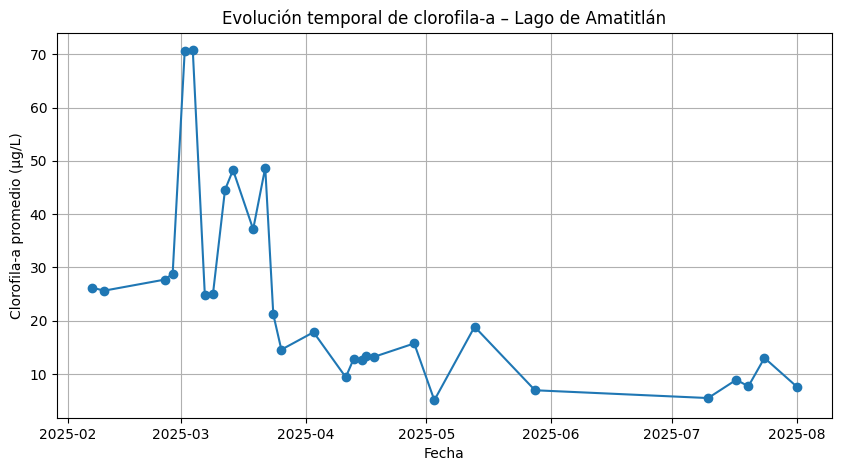

In [26]:
import os
import numpy as np
import rasterio
from rasterio.mask import mask
from rasterio.warp import transform_geom
import matplotlib.pyplot as plt
import pandas as pd

geom_wgs84 = fc["features"][0]["geometry"]

def safe_div(a, b):
    out = np.full_like(a, np.nan, dtype="float32")
    m = (b != 0) & np.isfinite(a) & np.isfinite(b)
    out[m] = a[m] / b[m]
    return out

def procesar_imagen(path):
    with rasterio.open(path) as src:
        geom_raster = transform_geom("EPSG:4326", src.crs.to_string(), geom_wgs84, precision=6)
        band_dtype = np.dtype(src.dtypes[0])
        int_nodata = src.nodata if (src.nodata is not None and np.issubdtype(band_dtype, np.integer)) else -32768

        data, _ = mask(
            src,
            [geom_raster],
            crop=True,
            filled=True,
            nodata=int_nodata,
            indexes=list(range(1, 10))
        )

    data = data.astype("float32")
    data[data == float(int_nodata)] = np.nan

    B02, B03, B04, B05, B07, B08, B8A, B11, B12 = data

    # Escalado
    if np.nanmedian(B04) > 1.5:
        for arr in (B02, B03, B04, B05, B07, B08, B8A, B11, B12):
            arr /= 10000.0

    # Máscara de agua
    MNDWI = safe_div((B03 - B11), (B03 + B11 + 1e-8))
    NDWI  = safe_div((B03 - B08), (B03 + B08 + 1e-8))
    water = (MNDWI > 0.42) | (NDWI > 0.40)

    # FAI, NDCI, clorofila
    FAI  = B8A - B04 - (B07 - B04) * ((783 - 665) / (865 - 665))
    NDCI = safe_div((B05 - B04), (B05 + B04 + 1e-8))
    NDCI = np.clip(NDCI, -1, 1)

    chl = 826.57 * NDCI**3 - 176.43 * NDCI**2 + 19 * NDCI + 4.071
    chl[(chl < 0) | (chl > 500)] = np.nan

    chl_masked = np.where(water & (FAI <= 0.08), chl, np.nan)

    return np.nanmean(chl_masked)


resultados = []
for fname in sorted(os.listdir(".")):
    if fname.startswith("amatitlan_fecha_") and fname.endswith("_full.tif"):
        idx = fname.split("_")[2]
        fecha = fechas_cyano[int(idx)-1]
        promedio = procesar_imagen(fname)
        resultados.append({"fecha": fecha, "chl_promedio": promedio})
        print(f"{fecha}: {promedio:.2f} µg/L")


df = pd.DataFrame(resultados)
df["fecha"] = pd.to_datetime(df["fecha"])
df = df.sort_values("fecha")

plt.figure(figsize=(10,5))
plt.plot(df["fecha"], df["chl_promedio"], marker="o")
plt.title("Evolución temporal de clorofila-a – Lago de Amatitlán")
plt.xlabel("Fecha")
plt.ylabel("Clorofila-a promedio (µg/L)")
plt.grid(True)
plt.show()


La gráfica muestra cómo ha variado la concentración promedio de clorofila-a en el Lago de Amatitlán a lo largo del periodo analizado. Se pueden observar picos muy altos en la temporada de inicios y mediados de marzo, con valores que superan los 70 µg/L, lo que indica posibles períodos intensos de floración de cianobacterias. Después de esos picos la concentración desciende de forma abrupta y se mantiene en valores bajos a moderados durante abril, mayo y julio, con pequeñas fluctuaciones. Esta tendencia sugiere que las floraciones más importantes se concentran en un periodo específico del año, probablemente por als condiciones del clima.


Ahora analizamos todas las imágenes del lago para calcular en cada fecha el valor promedio de tres indicadores: clorofila-a, NDVI y NDWI. Con esos promedios se construye una tabla, se calcula las correlaciones entre clorofila-a y cada índice y se generan dos gráficos de dispersión para visualizar la relación de la clorofila-a con el NDVI y el NDWI.


,fecha,chl_prom,ndvi_prom,ndwi_prom
0,2025-02-07,26.187508,-56.713661,0.597010
1,2025-02-10,25.627298,-0.059471,0.349745
2,2025-02-25,27.698853,0.076921,0.230656
3,2025-02-27,28.789734,0.085162,0.232081
4,2025-03-02,70.660057,0.249601,0.141181
5,2025-03-04,70.756905,0.239018,0.151838
6,2025-03-07,24.735214,0.130827,0.177426
7,2025-03-09,24.925713,0.134698,0.178894
8,2025-03-12,44.533215,-113.330086,0.378130
9,2025-03-14,48.279793,-113.339233,0.321786


Correlación Pearson (chl vs NDVI): -0.34431274620800045
Correlación Pearson (chl vs NDWI): -0.4782278224425203


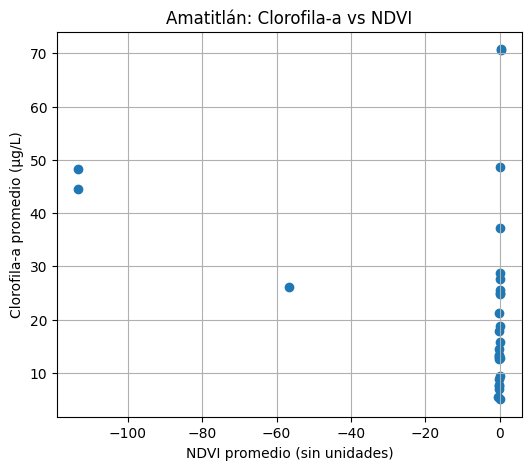

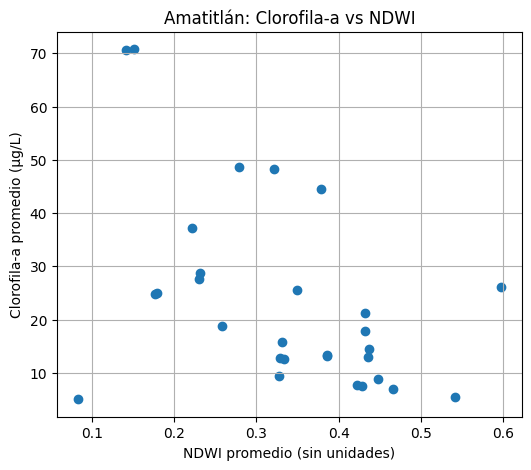

In [27]:
import os, numpy as np, pandas as pd, matplotlib.pyplot as plt
import rasterio
from rasterio.mask import mask
from rasterio.warp import transform_geom

geom_wgs84 = fc["features"][0]["geometry"]

def safe_div(a, b):
    out = np.full_like(a, np.nan, dtype="float32")
    m = (b != 0) & np.isfinite(a) & np.isfinite(b)
    out[m] = a[m] / b[m]
    return out

def promedios_chl_ndvi_ndwi(path):
    with rasterio.open(path) as src:
        geom_raster = transform_geom("EPSG:4326", src.crs.to_string(), geom_wgs84, precision=6)
        band_dtype = np.dtype(src.dtypes[0])
        int_nodata = src.nodata if (src.nodata is not None and np.issubdtype(band_dtype, np.integer)) else -32768

        data, _ = mask(src, [geom_raster], crop=True, filled=True, nodata=int_nodata, indexes=list(range(1,10)))

    data = data.astype("float32")
    data[data == float(int_nodata)] = np.nan
    B02, B03, B04, B05, B07, B08, B8A, B11, B12 = data

    if np.nanmedian(B04) > 1.5:
        for arr in (B02, B03, B04, B05, B07, B08, B8A, B11, B12):
            arr /= 10000.0

    MNDWI = safe_div((B03 - B11), (B03 + B11 + 1e-8))
    NDWI  = safe_div((B03 - B08), (B03 + B08 + 1e-8))
    water = (MNDWI > 0.42) | (NDWI > 0.40)


    FAI  = B8A - B04 - (B07 - B04) * ((783 - 665) / (865 - 665))
    NDCI = safe_div((B05 - B04), (B05 + B04 + 1e-8))
    NDCI = np.clip(NDCI, -1, 1)
    chl  = 826.57 * NDCI**3 - 176.43 * NDCI**2 + 19 * NDCI + 4.071
    chl[(chl < 0) | (chl > 500)] = np.nan
    chl_masked = np.where(water & (FAI <= 0.08), chl, np.nan)

    ndvi = safe_div((B08 - B04), (B08 + B04 + 1e-8))
    ndvi = np.where(water, ndvi, np.nan)
    ndwi = np.where(water, NDWI, np.nan)

    return float(np.nanmean(chl_masked)), float(np.nanmean(ndvi)), float(np.nanmean(ndwi))

rows = []
for fname in sorted(os.listdir(".")):
    if fname.startswith("amatitlan_fecha_") and fname.endswith("_full.tif"):
        idx = int(fname.split("_")[2])
        fecha = pd.to_datetime(fechas_cyano[idx-1])
        chl_m, ndvi_m, ndwi_m = promedios_chl_ndvi_ndwi(fname)
        rows.append({"fecha": fecha, "chl_prom": chl_m, "ndvi_prom": ndvi_m, "ndwi_prom": ndwi_m})

df_corr = pd.DataFrame(rows).sort_values("fecha").reset_index(drop=True)
display(df_corr)

# Correlaciones de Pearson
print("Correlación Pearson (chl vs NDVI):", df_corr[["chl_prom","ndvi_prom"]].dropna().corr().iloc[0,1])
print("Correlación Pearson (chl vs NDWI):", df_corr[["chl_prom","ndwi_prom"]].dropna().corr().iloc[0,1])

# Dispersograma chl vs NDVI
plt.figure(figsize=(6,5))
plt.scatter(df_corr["ndvi_prom"], df_corr["chl_prom"])
plt.xlabel("NDVI promedio (sin unidades)")
plt.ylabel("Clorofila-a promedio (µg/L)")
plt.title("Amatitlán: Clorofila-a vs NDVI")
plt.grid(True)
plt.show()

# Dispersograma chl vs NDWI
plt.figure(figsize=(6,5))
plt.scatter(df_corr["ndwi_prom"], df_corr["chl_prom"])
plt.xlabel("NDWI promedio (sin unidades)")
plt.ylabel("Clorofila-a promedio (µg/L)")
plt.title("Amatitlán: Clorofila-a vs NDWI")
plt.grid(True)
plt.show()


Podemos observar como para la primera gráfica de Clorofila-NVDI tenemos una correlación baja (-0.1023) lo que indica que la vegetación terrestre no tiene una relación clara con los niveles de clorofila-a detectados en el lago.  
En la segunda gráfica, la de Clorfila-a vs NDWI se observa una correlación negativa de -0.5065 lo que sugiere que cuando el NDWI promedio es más bajo (menos “agua pura” y más turbidez), la concentración de clorofila-a tiende a ser más alta, lo que coincide con escenarios de floración.  
Por último se observa como ols picos más altos de clorofila-a se dan en marzo, y en esos puntos el NDWI también es relativamente bajo reforzando la idea de que la reducción en el índice de agua está asociada a aumentos en cianobacterias.

Por último, se procesa una imagen para cada una de las fechas representativas (la de menor, mediana y mayor concentración de clorofila-a) y para cada una se procesó su imagen. Se unifican los rangos de color y se muestran en un mismo gráfico permitiendo comparar visualmente la distribución y la intensidad de la clorofila-a en escenarios de baja, intermedia y alta floración.


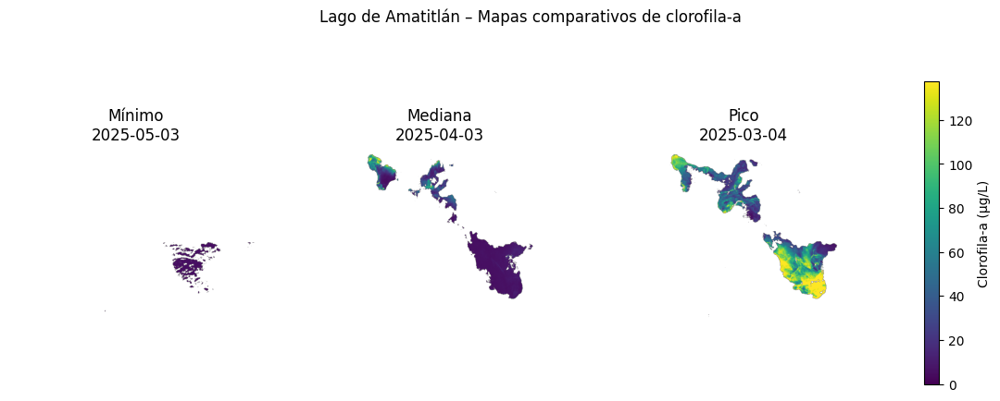

In [28]:

import numpy as np, matplotlib.pyplot as plt, rasterio
from rasterio.mask import mask
from rasterio.warp import transform_geom

geom_wgs84 = fc["features"][0]["geometry"]

def safe_div(a, b):
    out = np.full_like(a, np.nan, dtype="float32")
    m = (b != 0) & np.isfinite(a) & np.isfinite(b)
    out[m] = a[m] / b[m]
    return out

def chl_masked_from_tif(path):
    with rasterio.open(path) as src:
        geom_raster = transform_geom("EPSG:4326", src.crs.to_string(), geom_wgs84, precision=6)
        band_dtype = np.dtype(src.dtypes[0])
        int_nodata = src.nodata if (src.nodata is not None and np.issubdtype(band_dtype, np.integer)) else -32768
        data, _ = mask(src, [geom_raster], crop=True, filled=True, nodata=int_nodata, indexes=list(range(1,10)))
    data = data.astype("float32")
    data[data == float(int_nodata)] = np.nan
    B02, B03, B04, B05, B07, B08, B8A, B11, B12 = data
    if np.nanmedian(B04) > 1.5:
        for arr in (B02, B03, B04, B05, B07, B08, B8A, B11, B12):
            arr /= 10000.0
    MNDWI = safe_div((B03 - B11), (B03 + B11 + 1e-8))
    NDWI  = safe_div((B03 - B08), (B03 + B08 + 1e-8))
    water = (MNDWI > 0.42) | (NDWI > 0.40)
    FAI  = B8A - B04 - (B07 - B04) * ((783 - 665) / (865 - 665))
    NDCI = safe_div((B05 - B04), (B05 + B04 + 1e-8))
    NDCI = np.clip(NDCI, -1, 1)
    chl  = 826.57 * NDCI**3 - 176.43 * NDCI**2 + 19 * NDCI + 4.071
    chl[(chl < 0) | (chl > 500)] = np.nan
    return np.where(water & (FAI <= 0.08), chl, np.nan)

def fecha_a_fname(fecha_ts):
    fstr = fecha_ts.strftime("%Y-%m-%d")
    idx = fechas_cyano.index(fstr) + 1
    return f"amatitlan_fecha_{idx}_full.tif"

df_sorted = df_corr.sort_values("chl_prom").reset_index(drop=True)
fecha_min = df_sorted.iloc[0]["fecha"]
fecha_med = df_sorted.iloc[len(df_sorted)//2]["fecha"]
fecha_max = df_sorted.iloc[-1]["fecha"]

seleccion = [
    ("Mínimo", fecha_min, fecha_a_fname(fecha_min)),
    ("Mediana", fecha_med, fecha_a_fname(fecha_med)),
    ("Pico", fecha_max, fecha_a_fname(fecha_max)),
]

mapas = []
titulos = []
for etiqueta, f, fname in seleccion:
    arr = chl_masked_from_tif(fname)
    mapas.append(arr)
    titulos.append(f"{etiqueta}\n{f.date()}")

stack = np.dstack([m for m in mapas])
vmin = 0
vmax = np.nanpercentile(stack, 95)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for ax, arr, titulo in zip(axes, mapas, titulos):
    im = ax.imshow(arr, cmap="viridis", vmin=vmin, vmax=vmax)
    ax.set_title(titulo)
    ax.axis("off")

cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.85)
cbar.set_label("Clorofila-a (µg/L)")
fig.suptitle("Lago de Amatitlán – Mapas comparativos de clorofila-a", y=0.98)
plt.show()


POdemos observar claramente los cambios en la intensidad y distribución de la clorofila-a dependiendo del momento de año.  
El pico que hubo el 22 de marzo muestra una amplia zona del lago, específicamente en el sur lo que indica un evento de floración de cianobacterias extenso.  
En la fecha del 03 de abril las concentraciones son moderadas y se concentran en áreas específicas, lo que sugiere que hay una disminución de la floración.  
Por ĺtimo en a fecha del 03 de mayo apenas se detactan niveles significativos, lo que sugiere que no hay condiciones que provquen la expansión y crecimiento e la cianobacteria.  
De esta amanera se refuerza la hipótesis de qe las floraciones en este lago son estacionales.
